## **<font color='#0e77c2' size='6px'>Imports</font>**

In [ ]:
import cv2
import os
import pickle
import pandas as pd
import numpy as np
import string
import keras
import re
from time import time
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input, decode_predictions
from tensorflow.keras.layers import Input, Dropout, Dense, Embedding, LSTM, add, Bidirectional, BatchNormalization
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical, plot_model
from tensorflow.keras.optimizers import Adam

## **<font color='#0e77c2' size='6px'>Mounting Google Drive and unzipping the dataset folder</font>**

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

In [ ]:
# zip_file_path = "/content/drive/MyDrive/LAB3_Arcive.zip"
# with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
#      zip_ref.extractall('/content')

## **<font color='#0e77c2' size='6px'>Setting up the captions and the images description dictionary</font>**

This function reads a text file and returns what's inside as a contigous string

In [ ]:
def readText(path):
    with open(path) as f:
        caption = f.read()
    return caption

Building a list of captions

In [ ]:
captions_path = "/kaggle/input/flickr8k/captions.txt"
images_path = "/kaggle/input/flickr8k/Images/"
# Reading the captions text file as one contigous
captions = readText(captions_path)

# split it to seperate captions using the new line delimeter
captions = captions.split('\n')[:-1]

# drop the first element bacause it's irrelevant "image,caption"
captions = captions[1:]

# test it by printing the first caption
print(captions[1])

1000268201_693b08cb0e.jpg,A girl going into a wooden building .


Creating a dictinary that maps each image name to its list of captions and they are five

In [ ]:
descriptions = {}

for caption in captions:
  caption_elements = caption.split(',')
  img_name, one_caption = caption_elements[0], caption_elements[1]
  if descriptions.get(img_name) is None:
    descriptions[img_name] = []
  descriptions[img_name].append(one_caption)


# test it by printing the captions for some image
descriptions['1000268201_693b08cb0e.jpg']

['A child in a pink dress is climbing up a set of stairs in an entry way .',
 'A girl going into a wooden building .',
 'A little girl climbing into a wooden playhouse .',
 'A little girl climbing the stairs to her playhouse .',
 'A little girl in a pink dress going into a wooden cabin .']

Testing this further by rendering the image and its capptions

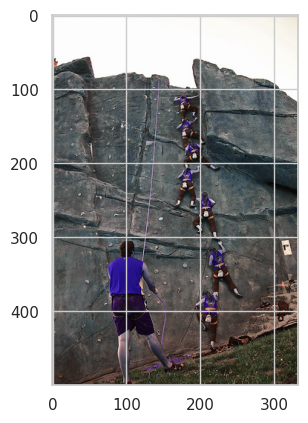

['A collage of one person climbing a cliff .',
 'A group of people are rock climbing on a rock climbing wall .',
 'A group of people climbing a rock while one man belays',
 'Seven climbers are ascending a rock face whilst another man stands holding the rope .',
 'Several climbers in a row are climbing the rock while the man in red watches and holds the line .']

In [ ]:
some_img_path = images_path + "1016887272_03199f49c4.jpg"
plt.imshow(cv2.imread(some_img_path))

# Showing the random image
plt.show()

# Then show its description using the dictionary
descriptions['1016887272_03199f49c4.jpg']

## **<font color='#0e77c2' size='6px'>Refining the Captions</font>**

In this process we get each capption and we do the following:


*   **Convert it to lower case words.**
*   **Remove the numbers and punctuations.**
*   **Remove the special characters of one charcter.**
*   **Remove numbers, and extra spaces**  
*   **Adding a starting and ending special words to denote the start and the end of the caption**








In [ ]:
def refine_caption(cap):
  cap = cap.lower()
  cap = re.sub('[^a-z]+', ' ', cap)
  cap = cap.split()
  cap = [s for s in cap if len(s) > 1]
  cap = ' '.join(cap)
  return cap

In [ ]:
for img_name, captions_list in descriptions.items():
  for i in range(len(captions_list)):
    captions_list[i] = refine_caption(captions_list[i])

In [ ]:
descriptions['1016887272_03199f49c4.jpg']

['collage of one person climbing cliff',
 'group of people are rock climbing on rock climbing wall',
 'group of people climbing rock while one man belays',
 'seven climbers are ascending rock face whilst another man stands holding the rope',
 'several climbers in row are climbing the rock while the man in red watches and holds the line']

## **<font color='#0e77c2' size='6px'>Setting up our vocabulary</font>**

Here is the total number of the unique words in our vocab

In [ ]:
vocab = set()

for img_name in descriptions.keys():
    [vocab.update(one_caption.split()) for one_caption in descriptions[img_name]]

print(f"Vocab Size : {len(vocab)}")

Vocab Size : 8257


Now let's filter them to a smaller number based on the frequency of each word according to some threshold, here the threshold is set to 5 meaning that we'll take the words that their frequency exceed 5 in all the captions for all the images

In [ ]:
threshold = 10

In [ ]:
from collections import defaultdict

words = []

def reduce_vocab_size():
    frequency_map = defaultdict(int)
    for img_name in descriptions.keys():
      for one_caption in descriptions[img_name]:
        for word in one_caption.split():
            frequency_map[word] += 1

    print(f"Vocab Size : {len(frequency_map)}")
    filtered_map = {word: count for word, count in frequency_map.items() if count >= threshold}

    return list(filtered_map.keys())


words = reduce_vocab_size()
print(f"Filtered Vocab Size : {len(words)}")

Vocab Size : 8257
Filtered Vocab Size : 1911


## **<font color='#0e77c2' size='6px'>Setting our training, validation, testing sets</font>**

In [ ]:
import copy

image_names = list(descriptions.keys())

# Define the sizes for training, validation, and testing sets
train_size = 6091
val_size = 1000
test_size = 1000

# Divide the image names into subsets
train_set = image_names[:train_size]
val_set = image_names[train_size:train_size+val_size]
test_set = image_names[train_size+val_size:train_size+val_size+test_size]

# Create deep copies for training, validation, and testing captions
train_descriptions = {img_name: copy.deepcopy(descriptions[img_name]) for img_name in train_set}
val_descriptions = {img_name: copy.deepcopy(descriptions[img_name]) for img_name in val_set}
test_descriptions = {img_name: copy.deepcopy(descriptions[img_name]) for img_name in test_set}

For the model to be able to recognize the start and the end of the caprions well, we'll add two special sequences for each training caption, one for the start of the caption called "**startseq**" and the other for the end and called "**endseq**"

In [ ]:
for img_name, captions_list in train_descriptions.items():
  for i in range(len(captions_list)):
    captions_list[i] = "startseq " + captions_list[i] + " endseq"

In [ ]:
print(train_descriptions["1002674143_1b742ab4b8.jpg"])
print(len(train_descriptions))
print(len(test_descriptions))
print(len(val_descriptions))

['startseq little girl covered in paint sits in front of painted rainbow with her hands in bowl endseq', 'startseq little girl is sitting in front of large painted rainbow endseq', 'startseq small girl in the grass plays with fingerpaints in front of white canvas with rainbow on it endseq', 'startseq there is girl with pigtails sitting in front of rainbow painting endseq', 'startseq young girl with pigtails painting outside in the grass endseq']
6091
1000
1000


## **<font color='#0e77c2' size='6px'>Images features extraction</font>**

Here we'll used **ResNet50** for this task. And here are some info about this model:


*   **ResNet50** is a deep convolutional neural network that has been pretrained on the ImageNet dataset, which consists of over a million images and 1000 classes.
*    This pretraining allows **ResNet50** to learn rich and diverse feature representations from images.
*   It has skip connections so it doesn't suffer from the problem of vanishing gradients

Defining the ResNet50 model by defining the input shape of each image to be 224 * 224 and 3 channels for the rgb colors of each image pixel

In [ ]:
newer_image_model = ResNet50(weights= 'imagenet', include_top=False,  input_shape = (224,224,3), pooling='avg')

# Add a custom dense layer to change the length of the feature vector
feature_vector_length = 2048  # Example: reduce to 256 dimensions

for layer in newer_image_model.layers:
    layer.trainable = False

# Create the new model
newer_image_model.summary()

Model: "resnet50"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 230, 230,  │          0 │ input_layer_1[0]… │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 56, 56,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 56, 56,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 56, 56,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 56, 56,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 56, 56,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_3_c

 Total params: 23,587,712 (89.98 MB)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 23,587,712 (89.98 MB)

From the summary we notice that the output feature vector is the output of the layer just before the final layer so we'll create a newer model that has the same imput as the one above and it's output is the vector of length 2048 which is the feature vector for this image, and we'll use that for the images feature extraction

In [ ]:
newer_image_model = Model(newer_image_model.input,newer_image_model.layers[-2].output)
newer_image_model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 230, 230,  │          0 │ input_layer[0][0] │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 56, 56,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 56, 56,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 56, 56,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 56, 56,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 56, 56,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_3_c

 Total params: 23,587,712 (89.98 MB)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 23,587,712 (89.98 MB)

Now we sould have each image have a size of 224 * 224 to match the input to the ResNet50 model and then we normalize the image and here's the function that does that:

In [ ]:
def preprocess_img(img_path):
    # Load the image and resize it to the target size (224x224 pixels)
    tmp = image.load_img(img_path, target_size=(224, 224))

    # Convert the image to a NumPy array
    tmp = image.img_to_array(tmp)

    # Add an extra dimension to represent the batch (batch size of 1)
    tmp = np.expand_dims(tmp, axis=0)

    # Normalize the image pixel values according to the preprocessing requirements of the model
    tmp = preprocess_input(tmp)

    # Return the preprocessed image
    return tmp

In [ ]:
# print("Some image before preprocessing")
# plt.imshow(cv2.imread(images_path+"1016887272_03199f49c4.jpg"))
# plt.axis("off")
# plt.show()

# print("The same image after preprocessing")
# img = preprocess_img(images_path+"1016887272_03199f49c4.jpg")
# plt.imshow(img[0])
# plt.axis("off")
# plt.show()

Now we ready to get the feature vector using the pretrained **ResNet50** model and here's the function that returns the feature vector for some image passed to it using its path

In [ ]:
def get_image_encoding(image_path):
  # first reprocess the image to match the input of the model
  img_224_224_3 = preprocess_img(image_path)
  # then predict the feature vector of the image using the pretrained model
  feature_vec = newer_image_model.predict(img_224_224_3)
  # then reshape this to be a 1D vector of 2048 elements and return it
  return feature_vec.reshape((feature_vector_length,))

Now let's encode each image of our training, testing, and validation sets using what we've created

In [ ]:
def create_encoding(input_dict_set):
  output_dict_encoding = {}
  for image_name in input_dict_set.keys():
    image_path = images_path +  image_name
    output_dict_encoding[image_name] = get_image_encoding(image_path)
  return output_dict_encoding

In [ ]:
# train_images_encoding = {}
# test_images_encoding = {}
# val_images_encoding = {}

# start_time = time()
# train_images_encoding = create_encoding(train_descriptions)
# end_time = time()
# print(f"Time taken for encoding the training set is: {end_time - start_time} Sec")

In [ ]:
# start_time = time()
# test_images_encoding = create_encoding(test_descriptions)
# end_time = time()
# print(f"Time taken for encoding the testing set is: {end_time - start_time} Sec")

In [ ]:
# start_time = time()
# val_images_encoding = create_encoding(val_descriptions)
# end_time = time()
# print(f"Time taken for encoding the Validation set is: {end_time - start_time} Sec")

After that we save the created encoding dictionaries in pickle files so that we don't wait that long time again

In [ ]:

# with open('train_images_encoding.pkl', 'wb') as f:
#     pickle.dump(train_images_encoding, f)

# with open('test_images_encoding.pkl', 'wb') as f:
#     pickle.dump(test_images_encoding, f)

# with open('val_images_encoding.pkl', 'wb') as f:
#     pickle.dump(val_images_encoding, f)

In [ ]:

train_images_encoding = {}
test_images_encoding = {}
val_images_encoding = {}

with open('/kaggle/input/new-frozen-features/train_images_encoding.pkl', 'rb') as f:
    train_images_encoding = pickle.load(f)

with open('/kaggle/input/new-frozen-features/test_images_encoding.pkl', 'rb') as f:
    test_images_encoding = pickle.load(f)

with open('/kaggle/input/new-frozen-features/val_images_encoding.pkl', 'rb') as f:
    val_images_encoding = pickle.load(f)



## **<font color='#0e77c2' size='6px'>Words Embedding</font>**

Word embeddings are dense vector representations of words that capture their meanings, semantic relationships, and syntactic roles. Unlike one-hot encoding, which represents words as sparse vectors, word embeddings represent words in a continuous vector space where semantically similar words are mapped to nearby points which could help the model alot to get the semantics of words and know which words are alike.

In this step, we will create word embeddings for the text data associated with the images. These embeddings will transform the textual descriptions into numerical form, which can be used as input features for various machine learning models.

First we need two maps or directories that will help us convert the textual representation into numeric (for model because it doesn't work on textual representation) and the numeric to text (because the final results will be the indices of the words in the vocab)

In [ ]:
word_to_index = {}
index_to_word = {}

for index, word in enumerate(words):
  word_to_index[word] = index + 1
  index_to_word[index + 1] = word

vocab_len = len(word_to_index)

# Then we need to add the two words that denote the start and the end of each training caption
word_to_index['startseq'] = vocab_len + 1
index_to_word[vocab_len + 1] = 'startseq'

word_to_index['endseq'] = vocab_len + 2
index_to_word[vocab_len + 2] = 'endseq'

vocab_len = len(word_to_index) + 1

print (f"Vocab length = {vocab_len}")

Vocab length = 1914


Then we need to get the length of the longest caption in the training captions because the model will accept sequences of the same length, so we'll need to **pad** the sequences whose length is smaller than tha max length

In [ ]:
max_caption_len = 0
for train_img_id in train_descriptions.keys():
  for cap in train_descriptions[train_img_id]:
    max_caption_len = max(max_caption_len, len(cap.split()))

![download.png](attachment:41ef0e03-d57b-4c7b-ac2f-68cb8d380a2e.png)Here comes the part where we need to help the produced model to predict a new word given the list of preceding words and the feature vector of the input image so we need to create 2 list of lists one for **in_sequence** and the other for **out_sequence** and the illustration is as follows:

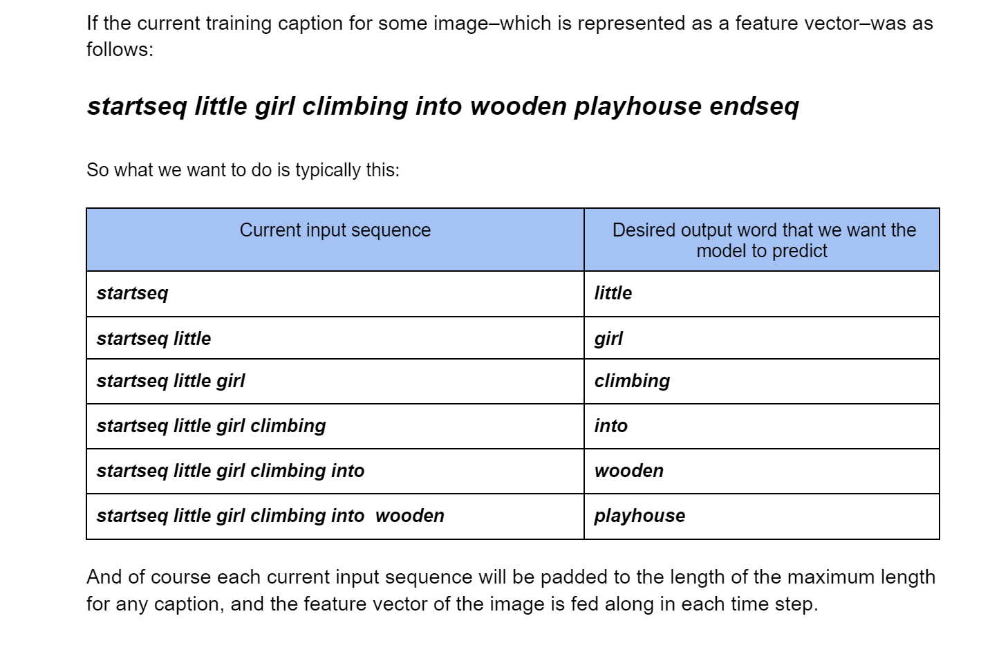

So to do this for each training example will require a lot of memory. so, to mandate this we'll process the training set in batches denoted by a certain batch size and this is the role of the following **data_generator** function and what this function does is as follows:


*    function is designed to generate batches of data for training a neural network model that processes image captions.
*   This function generates training examples by combining image features with tokenized and padded sequences of words from the image descriptions.


*   Generates batches on-the-fly, ensuring that only a small subset of the data is loaded into memory at any given time.

*   Converts target word indices into one-hot encoded vectors.


In [ ]:
def data_generator(train_descriptions, encoding_train, word_to_idx, max_caption_length, batch_size):
  # Initialize empty lists to hold batches of input and output data
  feature_vec, in_seq, out_target_word = list(), list(), list()

  currently_processed_examples = 0

  # Infinite loop to generate data indefinitely
  while True:
      for training_image_id, image_captions in train_descriptions.items():
        # by the end of this loop we would have preocessed one example
        currently_processed_examples += 1

        # Retrieve the precomputed image features for the current image
        image_feature_vec = train_images_encoding[training_image_id]

        for one_caption in image_captions:
            # Convert the description into a sequence of word indices
            seq = [word_to_idx[w] for w in one_caption.split() if w in word_to_index]

            # Generate input-output pairs for the sequence
            for i in range(1, len(seq)):
                  # Input sequence is the words up to the current position
                  in_seq_i = seq[0 : i]
                  # Output word is the current word
                  out_target_word_i = seq[i]

                  # And of course we'll need to pad each in_seq_i to the max_caption_length
                  in_seq_i = pad_sequences([in_seq_i], maxlen=max_caption_length, value=0, padding='post')[0]
                  # And after that encode the target out word with one hot encoding
                  out_target_word_i = to_categorical([out_target_word_i], num_classes=vocab_len)[0]

                  # Append the image features, input sequence, and output word to the respective lists
                  feature_vec.append(image_feature_vec)
                  in_seq.append(in_seq_i)
                  out_target_word.append(out_target_word_i)

        if currently_processed_examples == batch_size:
          # Yield the batch as a tuple of arrays
          feature_vec, in_seq, out_target_word = np.array(feature_vec), np.array(in_seq), np.array(out_target_word)

          yield {'image_features_input': feature_vec, 'text_sequence_input': in_seq}, out_target_word
          # Reset the lists and counter for the next batch
          feature_vec, in_seq, out_target_word = list(), list(), list()
          currently_processed_examples = 0

In [ ]:
def validation_data_generator(descriptions, encoding, word_to_idx, max_caption_length, batch_size):
    # Initialize empty lists to hold batches of input and output data
    feature_vec, in_seq, out_target_word = list(), list(), list()

    currently_processed_examples = 0

    # Infinite loop to generate data indefinitely
    while True:
        for image_id, captions in descriptions.items():
            # by the end of this loop we would have processed one example
            currently_processed_examples += 1

            # Retrieve the precomputed image features for the current image
            image_feature_vec = encoding[image_id]

            for one_caption in captions:
                # Convert the description into a sequence of word indices
                seq = [word_to_idx[w] for w in one_caption.split() if w in word_to_idx]

                # Generate input-output pairs for the sequence
                for i in range(1, len(seq)):
                    # Input sequence is the words up to the current position
                    in_seq_i = seq[0: i]
                    # Output word is the current word
                    out_target_word_i = seq[i]

                    # And of course we'll need to pad each in_seq_i to the max_caption_length
                    in_seq_i = pad_sequences([in_seq_i], maxlen=max_caption_length, value=0, padding='post')[0]
                    # And after that encode the target out word with one hot encoding
                    out_target_word_i = to_categorical([out_target_word_i], num_classes=vocab_len)[0]

                    # Append the image features, input sequence, and output word to the respective lists
                    feature_vec.append(image_feature_vec)
                    in_seq.append(in_seq_i)
                    out_target_word.append(out_target_word_i)

            if currently_processed_examples == batch_size:
                # Yield the batch as a tuple of arrays
                feature_vec, in_seq, out_target_word = np.array(feature_vec), np.array(in_seq), np.array(out_target_word)

                yield {'image_features_input': feature_vec, 'text_sequence_input': in_seq}, out_target_word
                # Reset the lists and counter for the next batch
                feature_vec, in_seq, out_target_word = list(), list(), list()
                currently_processed_examples = 0

## **<font color='#0e77c2' size='6px'>Model Creation</font>**

### Image Features Layers

- **Image Features Input Layer**
    - **Layer**: `Input`
    - **Function**: Serves as the input layer for the image features.
    - **Input Shape**: `(2048,)`
    - **Output Shape**: `(2048,)`
    - **Description**: This layer accepts the image feature vectors extracted from a pre-trained CNN.

- **Image Features Dropout Layer**
    - **Layer**: `Dropout`
    - **Function**: Applies dropout to the image features to prevent overfitting and increase generalization.
    - **Input Shape**: `(2048,)`
    - **Output Shape**: `(2048,)`
    - **Description**: Drops out 44% of the input units to help the model generalize better.

- **Image Features Dense Layer**
    - **Layer**: `Dense`
    - **Function**: Transforms the image feature vector to a smaller, more manageable size.
    - **Input Shape**: `(2048,)`
    - **Output Shape**: `(256,)`
    - **Description**: Reduces the dimensionality of the image features to 256 using a fully connected layer with ReLU activation.

- **Image Features Batch Normalization Layer**
    - **Layer**: `BatchNormalization`
    - **Function**: Normalizes the output of the previous layer to improve training stability and performance.
    - **Input Shape**: `(256,)`
    - **Output Shape**: `(256,)`
    - **Description**: Applies batch normalization to the dense layer output.

### Captions Layers

- **Text Sequence Input Layer**
    - **Layer**: `Input`
    - **Function**: Serves as the input layer for the text sequences (captions).
    - **Input Shape**: `(max_caption_len,)`
    - **Output Shape**: `(max_caption_len,)`
    - **Description**: This layer accepts sequences of word indices representing the captions.

- **Text Embedding Layer**
    - **Layer**: `Embedding`
    - **Function**: Converts word indices to dense vectors of fixed size.
    - **Input Shape**: `(max_caption_len,)`
    - **Output Shape**: `(max_caption_len, 256)`
    - **Description**: Maps each word index in the caption to a 256-dimensional dense vector.

- **Text Dropout Layer**
    - **Layer**: `Dropout`
    - **Function**: Applies dropout to the embeddings to prevent overfitting and increase generalization.
    - **Input Shape**: `(max_caption_len, 256)`
    - **Output Shape**: `(max_caption_len, 256)`
    - **Description**: Drops out 44% of the input units to help the model generalize better.

- **Text Bidirectional LSTM Layer**
    - **Layer**: `Bidirectional(LSTM)`
    - **Function**: Processes the text sequences using a bidirectional LSTM to capture dependencies in both forward and backward directions.
    - **Input Shape**: `(max_caption_len, 256)`
    - **Output Shape**: `(512,)`
    - **Description**: Outputs a 512-dimensional vector by concatenating the forward and backward LSTM outputs (256 units each).

- **Text Batch Normalization Layer**
    - **Layer**: `BatchNormalization`
    - **Function**: Normalizes the output of the LSTM layer to improve training stability and performance.
    - **Input Shape**: `(512,)`
    - **Output Shape**: `(512,)`
    - **Description**: Applies batch normalization to the LSTM output.

- **Text Dense Layer**
    - **Layer**: `Dense`
    - **Function**: Adjusts the dimensionality of the text features to match the image feature size.
    - **Input Shape**: `(512,)`
    - **Output Shape**: `(256,)`
    - **Description**: Transforms the 512-dimensional LSTM output to a 256-dimensional vector using a fully connected layer with ReLU activation.

### Combined Layers

- **Decoder Combined Layer**
    - **Layer**: `add`
    - **Function**: Combines the processed image features and text features.
    - **Input Shape**: `[(256,), (256,)]`
    - **Output Shape**: `(256,)`
    - **Description**: Adds the image and text feature vectors element-wise.

- **Decoder Dense Layer**
    - **Layer**: `Dense`
    - **Function**: Merges the combined features.
    - **Input Shape**: `(256,)`
    - **Output Shape**: `(256,)`
    - **Description**: Applies a fully connected layer with ReLU activation to the combined features.

- **Decoder Dropout Layer**
    - **Layer**: `Dropout`
    - **Function**: Applies dropout to the merged features to prevent overfitting and increase generalization.
    - **Input Shape**: `(256,)`
    - **Output Shape**: `(256,)`
    - **Description**: Drops out 44% of the input units to help the model generalize better.

- **Output Layer**
    - **Layer**: `Dense`
    - **Function**: Predicts the next word in the caption using softmax activation.
    - **Input Shape**: `(256,)`
    - **Output Shape**: `(vocab_len,)`
    - **Description**: Outputs a probability distribution over the vocabulary for the next word.

### Model Compilation

- **Optimizer**: Adam with a learning rate of 0.001
- **Loss Function**: Categorical cross-entropy
- **Metrics**: Accuracy

In [ ]:
image_drop_rate = 0.44
embedding_drop_rate = 0.44
epochs = 40

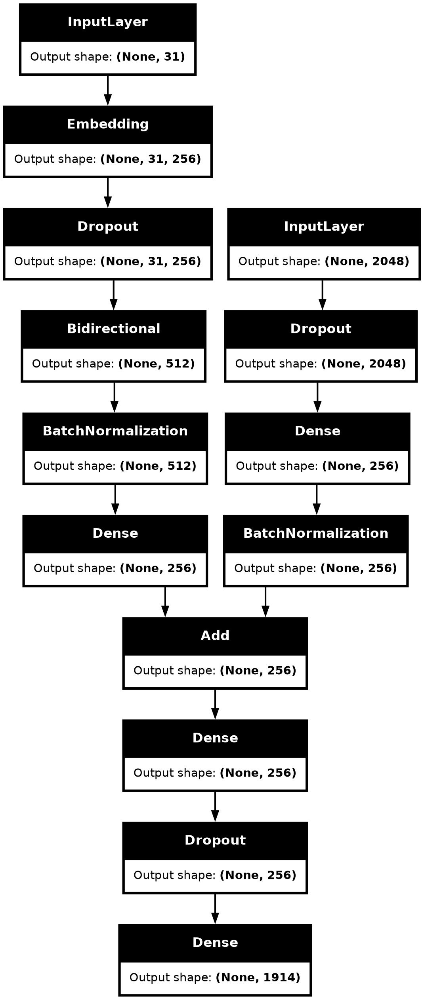

In [ ]:
# Image features layers
image_features_input = Input(shape=(feature_vector_length,), name="image_features_input")
image_features_dropout = Dropout(image_drop_rate, name="image_features_dropout")(image_features_input)
image_features_dense = Dense(256, activation='relu', name="image_features_dense")(image_features_dropout)
image_features_bn = BatchNormalization(name="image_features_bn")(image_features_dense)

# Captions layers
text_sequence_input = Input(shape=(max_caption_len,), name="text_sequence_input")
text_embedding = Embedding(vocab_len, 256, mask_zero=False, name="text_embedding")(text_sequence_input)
text_dropout = Dropout(embedding_drop_rate, name="text_dropout")(text_embedding)
text_lstm = Bidirectional(LSTM(256, name="text_lstm", return_sequences=False))(text_dropout)
text_bn = BatchNormalization(name="text_bn")(text_lstm)

# Adjusting text features to match image feature size
text_dense = Dense(256, activation='relu', name="text_dense")(text_bn)

# Combine the processed image features and text features
decoder_combined = add([image_features_bn, text_dense], name="decoder_combined")
decoder_dense = Dense(256, activation='relu', name="decoder_dense")(decoder_combined)
decoder_dropout = Dropout(embedding_drop_rate, name="decoder_dropout")(decoder_dense)
output = Dense(vocab_len, activation='softmax', name="output")(decoder_dropout)

# Define the model with image and text inputs and a single output
model = Model(inputs=[image_features_input, text_sequence_input], outputs=output, name="Image_Captioning_Model")

# Compile the model with categorical cross-entropy loss and the Adam optimizer
optimizer = Adam(learning_rate=0.001)
model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

# Plot the model architecture
plot_model(model, show_shapes=True, to_file='model_architecture.png', dpi=150)


- Here train the above created model using data generator and model fit.
- Monitor Loss and Accuracy on validation set using model evaluate.

In [ ]:
batch_size = 32
steps = len(train_descriptions) // batch_size
val_steps = len(val_descriptions) // batch_size

for i in range(epochs):
    print("epoch ", i+1, "/", epochs)
    generator = data_generator(train_descriptions, train_images_encoding, word_to_index, max_caption_len, batch_size)
    model.fit(generator, epochs=1, steps_per_epoch=steps, verbose=1)

    # Evaluate after each epoch
    val_generator = validation_data_generator(val_descriptions, val_images_encoding, word_to_index, max_caption_len, batch_size)
    val_loss, val_accuracy = model.evaluate(val_generator, steps=val_steps, verbose=1)
    print(f'Validation Loss: {val_loss}')
    print(f'Validation Accuracy: {val_accuracy}')

epoch  1 / 40
190/190 ━━━━━━━━━━━━━━━━━━━━ 24s 108ms/step - accuracy: 0.1257 - loss: 5.5047
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 85ms/step - accuracy: 0.0749 - loss: 5.2353
Validation Loss: 5.2542805671691895
Validation Accuracy: 0.07501420378684998
epoch  2 / 40
190/190 ━━━━━━━━━━━━━━━━━━━━ 20s 107ms/step - accuracy: 0.2375 - loss: 4.0926
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.1680 - loss: 4.3879
Validation Loss: 4.4083075523376465
Validation Accuracy: 0.16556166112422943
epoch  3 / 40
190/190 ━━━━━━━━━━━━━━━━━━━━ 20s 104ms/step - accuracy: 0.2777 - loss: 3.6672
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.2113 - loss: 4.0455
Validation Loss: 4.072999000549316
Validation Accuracy: 0.2085622251033783
epoch  4 / 40
190/190 ━━━━━━━━━━━━━━━━━━━━ 20s 105ms/step - accuracy: 0.2953 - loss: 3.4685
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.2353 - loss: 3.8555
Validation Loss: 3.8853142261505127
Validation Accuracy: 0.23137499392032623
epoch  5 / 40
190/190 ━━━━━━━━

In [ ]:
batch_size = 32
val_steps = len(val_descriptions) // batch_size

# Evaluate
val_generator = validation_data_generator(val_descriptions, val_images_encoding, word_to_index, max_caption_len, batch_size)
val_loss, val_accuracy = model.evaluate(val_generator, steps=val_steps, verbose=1)
print(f'Validation Loss: {val_loss}')
print(f'Validation Accuracy: {val_accuracy}')

31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 81ms/step - accuracy: 0.2756 - loss: 3.9086
Validation Loss: 3.9465410709381104
Validation Accuracy: 0.27183178067207336


save the model.

In [ ]:
# file_path = '/kaggle/working/our_model_35_2_0.35.h5'
# if os.path.exists(file_path):
#     os.remove(file_path)

# model.save(file_path)

load the model

In [ ]:
# from keras.models import load_model
# model = load_model('/kaggle/input/our-model-75-3-0-45/our_model_75_3_0.45.h5')
# model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
# model.summary()

function to predict the caption giving the image encoding.

In [ ]:
from tqdm import tqdm

def predict_caption(image):
    in_cap = 'startseq'
    for i in tqdm(range(max_caption_len), desc="Generating caption"):
        seq = [word_to_index[w] for w in in_cap.split() if w in word_to_index]
        seq = pad_sequences([seq], maxlen=max_caption_len, padding='post')
        y_hat = model.predict([image, seq], verbose=0)
        y_hat = y_hat.argmax()
        predicted_word = index_to_word[y_hat]
        in_cap += " " + predicted_word

        if predicted_word == 'endseq':
            break

    # Remove 'startseq' and 'endseq' from the predicted caption
    final_caption = in_cap.split()[1:-1]
    return ' '.join(final_caption)

function to calculate the BLUE score of the validation and test set in batches to avoid memory crash.

In [ ]:
from itertools import islice
from nltk.translate.bleu_score import corpus_bleu

def calculate_bleu_scores_in_batches(model, descriptions, image_encoding, batch_size):
    ids = list(descriptions.keys())
    bleu1 = 0
    bleu2 = 0
    steps = len(ids) / batch_size
    for start in range(0, len(ids), batch_size):
        actual, predicted = [], []
        end = min(start + batch_size, len(ids))
        batch_ids = ids[start:end]

        for id in batch_ids:
            # Predict the caption for the image
            y_pred = predict_caption(image_encoding[id].reshape((1, 2048))).split()
            y_pred = y_pred[1:len(y_pred) - 1]  # Remove 'startseq' and 'endseq'

            # Get actual captions
            actual_captions = [caption.split() for caption in descriptions[id]]

            # Append to lists
            actual.append(actual_captions)
            predicted.append(y_pred)

        # Calculate BLEU scores
        bleu1 += corpus_bleu(actual, predicted, weights=(1.0, 0, 0, 0))
        bleu2 += corpus_bleu(actual, predicted, weights=(0.6, 0.4, 0, 0))

    print("steps: ", steps)
    return bleu1/steps, bleu2/steps

Calculate the blue score of the validation set

In [ ]:
 # Calculate BLEU Scores
bleu1, bleu2 = calculate_bleu_scores_in_batches(model, val_descriptions, val_images_encoding, 64)
print(f"BLEU-1 Score: {bleu1:.4f}")
print(f"BLEU-2 Score: {bleu2:.4f}")

Generating caption:  16%|█▌        | 5/31 [00:00<00:01, 13.76it/s]

steps:  15.625
BLEU-1 Score: 0.5043
BLEU-2 Score: 0.3172


Hyperparamter tuning

Experiment with various model hyperparameters through Hyperparameter Tuning.

In [ ]:
# Data as a list of dictionaries
data = [
    {"threshold": 0, "Dropout ratio image": 0.4, "Dropout ratio text": 0.4, "epochs": 35, "BLUE score1": 0.4788, "BLUE score2": 0.2898, "Accuracy train": 0.4588, "Loss train": 2.1105, "Accuracy val": 0.2753, "Loss val": 5.1691},
    {"threshold": 3, "Dropout ratio image": 0.4, "Dropout ratio text": 0.4, "epochs": 35, "BLUE score1": 0.4877, "BLUE score2": 0.2982, "Accuracy train": 0.4399, "Loss train": 2.2139, "Accuracy val": 0.2804, "Loss val": 4.525},
    {"threshold": 5, "Dropout ratio image": 0.42, "Dropout ratio text": 0.42, "epochs": 35, "BLUE score1": 0.4973, "BLUE score2": 0.3095, "Accuracy train": 0.4079, "Loss train": 2.435, "Accuracy val": 0.2675, "Loss val": 4.2663},
    {"threshold": 6, "Dropout ratio image": 0.44, "Dropout ratio text": 0.44, "epochs": 30, "BLUE score1": 0.4982, "BLUE score2": 0.3088, "Accuracy train": 0.3862, "Loss train": 2.5866, "Accuracy val": 0.2794, "Loss val": 3.8089},
    {"threshold": 8, "Dropout ratio image": 0.44, "Dropout ratio text": 0.44, "epochs": 40, "BLUE score1": 0.4949, "BLUE score2": 0.3051, "Accuracy train": 0.4089, "Loss train": 2.4223, "Accuracy val": 0.2775, "Loss val": 4.022},
    {"threshold": 10, "Dropout ratio image": 0.44, "Dropout ratio text": 0.44, "epochs": 40, "BLUE score1": 0.5038, "BLUE score2": 0.3155, "Accuracy train": 0.4081, "Loss train": 2.4233, "Accuracy val": 0.2802, "Loss val": 3.9144},
    {"threshold": 10, "Dropout ratio image": 0.44, "Dropout ratio text": 0.44, "epochs": 35, "BLUE score1": 0.5021, "BLUE score2": 0.3128, "Accuracy train": 0.4014, "Loss train": 2.4726, "Accuracy val": 0.2821, "Loss val": 3.78423},
    {"threshold": 12, "Dropout ratio image": 0.45, "Dropout ratio text": 0.45, "epochs": 40, "BLUE score1": 0.4955, "BLUE score2": 0.3112, "Accuracy train": 0.4042, "Loss train": 2.4523, "Accuracy val": 0.2779, "Loss val": 3.9158},
]

# Create DataFrame
df = pd.DataFrame(data)

# Display the DataFrame as a table
print(df)


   threshold  Dropout ratio image  Dropout ratio text  epochs  BLUE score1  \
0          0                 0.40                0.40      35       0.4788   
1          3                 0.40                0.40      35       0.4877   
2          5                 0.42                0.42      35       0.4973   
3          6                 0.44                0.44      30       0.4982   
4          8                 0.44                0.44      40       0.4949   
5         10                 0.44                0.44      40       0.5038   
6         10                 0.44                0.44      35       0.5021   
7         12                 0.45                0.45      40       0.4955   

   BLUE score2  Accuracy train  Loss train  Accuracy val  Loss val  
0       0.2898          0.4588      2.1105        0.2753   5.16910  
1       0.2982          0.4399      2.2139        0.2804   4.52500  
2       0.3095          0.4079      2.4350        0.2675   4.26630  
3       0.3088       

In [ ]:
from IPython.display import display

# Display the DataFrame
display(df)


,threshold,Dropout ratio image,Dropout ratio text,epochs,BLUE score1,BLUE score2,Accuracy train,Loss train,Accuracy val,Loss val
0,0,0.40,0.40,35,0.4788,0.2898,0.4588,2.1105,0.2753,5.16910
1,3,0.40,0.40,35,0.4877,0.2982,0.4399,2.2139,0.2804,4.52500
2,5,0.42,0.42,35,0.4973,0.3095,0.4079,2.4350,0.2675,4.26630
3,6,0.44,0.44,30,0.4982,0.3088,0.3862,2.5866,0.2794,3.80890
4,8,0.44,0.44,40,0.4949,0.3051,0.4089,2.4223,0.2775,4.02200
5,10,0.44,0.44,40,0.5038,0.3155,0.4081,2.4233,0.2802,3.91440
6,10,0.44,0.44,35,0.5021,0.3128,0.4014,2.4726,0.2821,3.78423
7,12,0.45,0.45,40,0.4955,0.3112,0.4042,2.4523,0.2779,3.91580


/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  

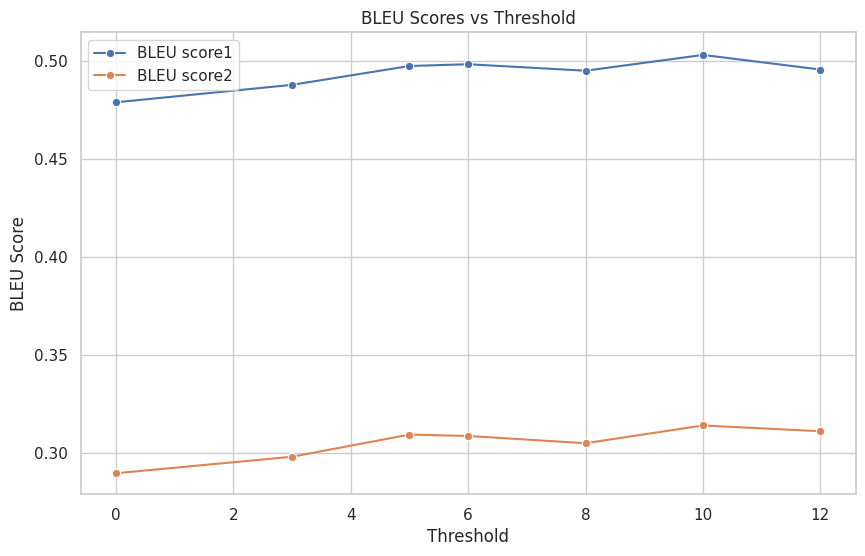

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  

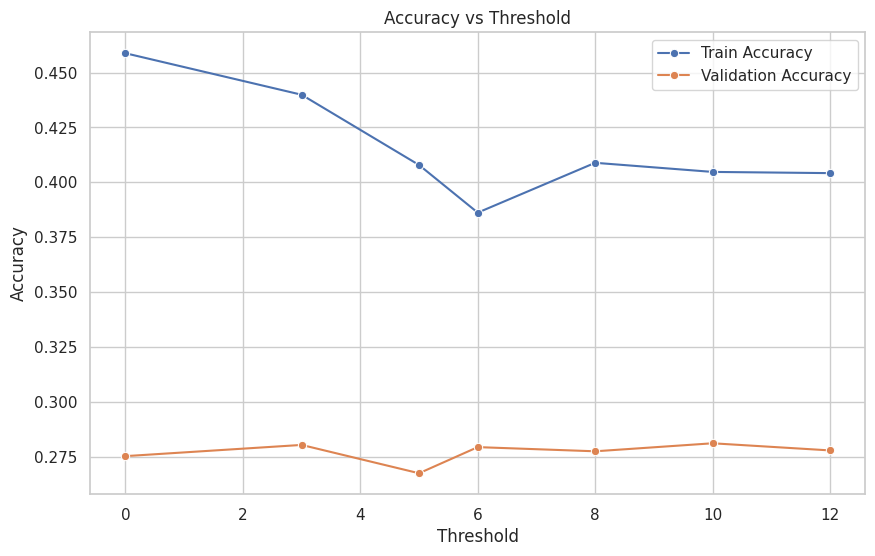

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  

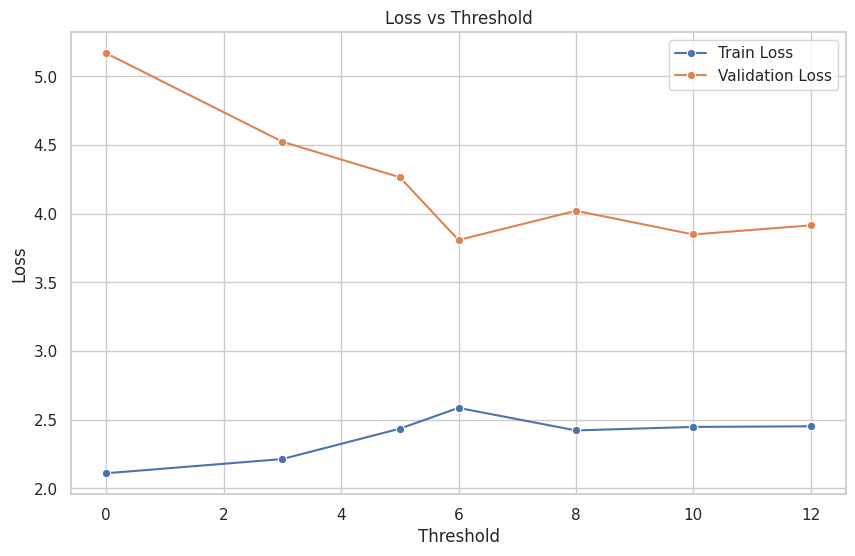

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  

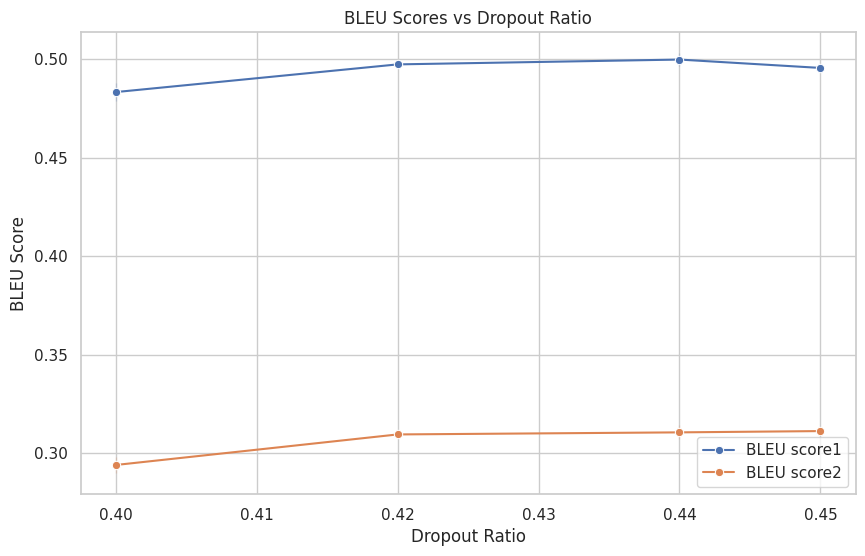

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  

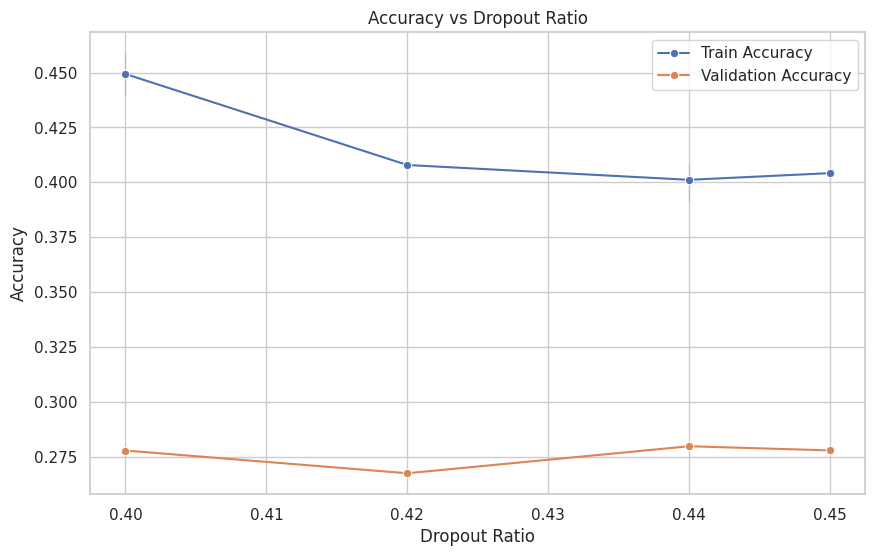

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  

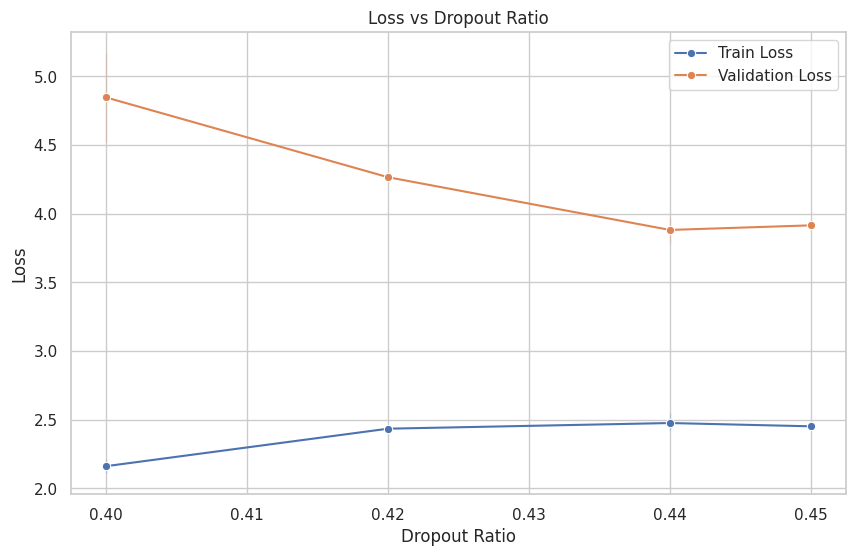

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the style for seaborn
sns.set(style="whitegrid")

# Plot BLEU scores
plt.figure(figsize=(10, 6))
sns.lineplot(x='threshold', y='BLUE score1', data=df, marker='o', label='BLEU score1')
sns.lineplot(x='threshold', y='BLUE score2', data=df, marker='o', label='BLEU score2')
plt.title('BLEU Scores vs Threshold')
plt.xlabel('Threshold')
plt.ylabel('BLEU Score')
plt.legend()
plt.show()

# Plot Training and Validation Accuracy
plt.figure(figsize=(10, 6))
sns.lineplot(x='threshold', y='Accuracy train', data=df, marker='o', label='Train Accuracy')
sns.lineplot(x='threshold', y='Accuracy val', data=df, marker='o', label='Validation Accuracy')
plt.title('Accuracy vs Threshold')
plt.xlabel('Threshold')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

# Plot Training and Validation Loss
plt.figure(figsize=(10, 6))
sns.lineplot(x='threshold', y='Loss train', data=df, marker='o', label='Train Loss')
sns.lineplot(x='threshold', y='Loss val', data=df, marker='o', label='Validation Loss')
plt.title('Loss vs Threshold')
plt.xlabel('Threshold')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Plot BLEU scores
plt.figure(figsize=(10, 6))
sns.lineplot(x='Dropout ratio image', y='BLUE score1', data=df, marker='o', label='BLEU score1')
sns.lineplot(x='Dropout ratio image', y='BLUE score2', data=df, marker='o', label='BLEU score2')
plt.title('BLEU Scores vs Dropout Ratio')
plt.xlabel('Dropout Ratio')
plt.ylabel('BLEU Score')
plt.legend()
plt.show()

# Plot Training and Validation Accuracy
plt.figure(figsize=(10, 6))
sns.lineplot(x='Dropout ratio text', y='Accuracy train', data=df, marker='o', label='Train Accuracy')
sns.lineplot(x='Dropout ratio text', y='Accuracy val', data=df, marker='o', label='Validation Accuracy')
plt.title('Accuracy vs Dropout Ratio')
plt.xlabel('Dropout Ratio')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

# Plot Training and Validation Loss
plt.figure(figsize=(10, 6))
sns.lineplot(x='Dropout ratio text', y='Loss train', data=df, marker='o', label='Train Loss')
sns.lineplot(x='Dropout ratio text', y='Loss val', data=df, marker='o', label='Validation Loss')
plt.title('Loss vs Dropout Ratio')
plt.xlabel('Dropout Ratio')
plt.ylabel('Loss')
plt.legend()
plt.show()



After Hyper parameter tuning the best parameters which will be applied on the test set are:


report Loss, Accuracy and BLEU score on test set

In [ ]:
batch_size = 32
test_steps = len(test_descriptions) // batch_size

# Evaluate
test_generator = validation_data_generator(test_descriptions, test_images_encoding, word_to_index, max_caption_len, batch_size)
test_loss, test_accuracy = model.evaluate(test_generator, steps=test_steps, verbose=1)
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.2962 - loss: 3.7739
Test Loss: 3.8025407791137695
Test Accuracy: 0.2874595522880554


In [ ]:
 # Calculate BLEU Scores
bleu1, bleu2 = calculate_bleu_scores_in_batches(model, test_descriptions, test_images_encoding, 64)
print(f"BLEU-1 Score: {bleu1:.4f}")
print(f"BLEU-2 Score: {bleu2:.4f}")

Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 14.08it/s]

steps:  15.625
BLEU-1 Score: 0.4823
BLEU-2 Score: 0.3088


### Caption Generation

- Showcase examples from the test set where the model performs well.
- Highlight instances where the model performs poorly and analyze the reasons behind it.
- Download images from the internet for testing, Input these images into the trained model and Demonstrate how to generate captions for the input images.

In [ ]:
from nltk.translate.bleu_score import sentence_bleu

def calculate_bleu_score(true_captions, predicted_caption):
    references = [caption.split() for caption in true_captions]
    candidate = predicted_caption.split()
    bleu_score = sentence_bleu(references, candidate, weights=(0.6, 0.4, 0, 0))
    return bleu_score

In [ ]:
def evaluate_test_set(test_descriptions, image_encodings, predict_function, top_n=10):
    scores = []

    for id, true_captions in test_descriptions.items():
        # Get the predicted caption
        predicted_caption = predict_function(image_encodings[id].reshape((1, 2048)))

        # Calculate the BLEU score
        bleu_score = calculate_bleu_score(true_captions, predicted_caption)

        # Store the score with the corresponding image ID
        scores.append((id, bleu_score))

    # Sort scores in descending order for the best scores
    scores.sort(key=lambda x: x[1], reverse=True)

    # Get the top N and bottom N image IDs
    best_ids = [id for id, score in scores[:top_n]]
    worst_ids = [id for id, score in scores[-top_n:]]

    return best_ids, worst_ids


Generating caption:  16%|█▌        | 5/31 [00:00<00:01, 13.04it/s]
/opt/conda/lib/python3.10/site-packages/nltk/translate/bleu_score.py:490: UserWarning: 
Corpus/Sentence contains 0 counts of 4-gram overlaps.
BLEU scores might be undesirable; use SmoothingFunction().
  warnings.warn(_msg)
Generating caption:  32%|███▏      | 10/31 [00:00<00:01, 14.19it/s]
/opt/conda/lib/python3.10/site-packages/nltk/translate/bleu_score.py:490: UserWarning: 
Corpus/Sentence contains 0 counts of 3-gram overlaps.
BLEU scores might be undesirable; use SmoothingFunction().
  warnings.warn(_msg)
Generating caption:  32%|███▏      | 10/31 [00:00<00:01, 14.87it/s]
/opt/conda/lib/python3.10/site-packages/nltk/translate/bleu_score.py:490: UserWarning: 
Corpus/Sentence contains 0 counts of 2-gram overlaps.
BLEU scores might be undesirable; use SmoothingFunction().
  warnings.warn(_msg)
Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 14.75it/s]
/tmp/ipykernel_34/2015452906.py:7: MatplotlibDeprecationWarni

best test results
actual captions
white dog and two black dogs playing
white poodle and black poodles are playing on the grass
white poodle and two black poodles are playing in the grass on an autumn day
white poodle is climbing over black poodle
two black dogs and one white dog interact


Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 13.84it/s]


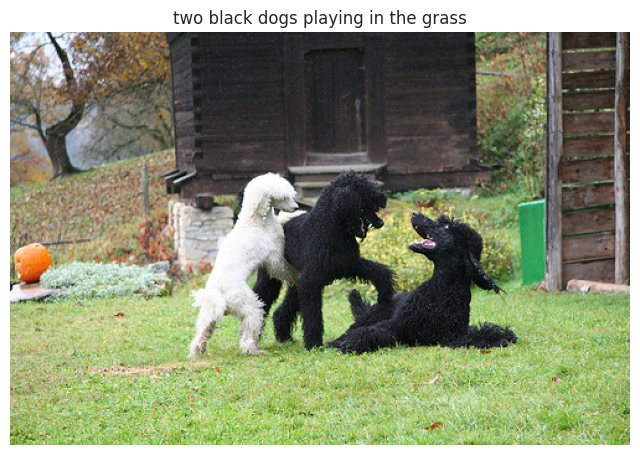

actual captions
brown dog about to jump on smaller black and tan dog
large dog playing with smaller dog
two dogs are playing together outside
two dogs playing in the grass with an adult nearby
two dogs playing with each other


Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 13.68it/s]


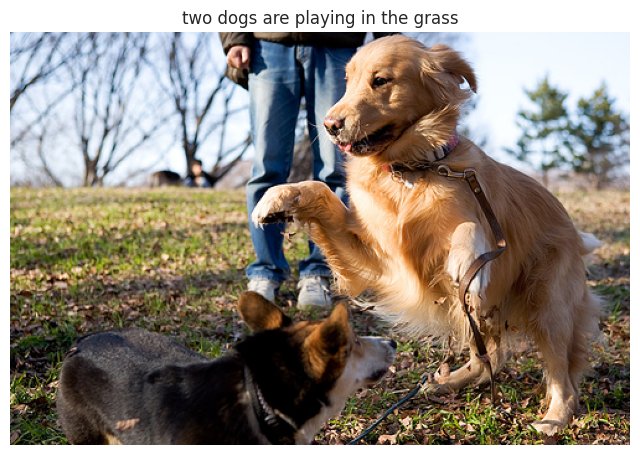

actual captions
two big brown dogs running through the snow
two brown dogs are running over snow in line
two brown dogs walking through snow
two dogs running in the snow
two weimaraners running in the snow


Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 14.25it/s]


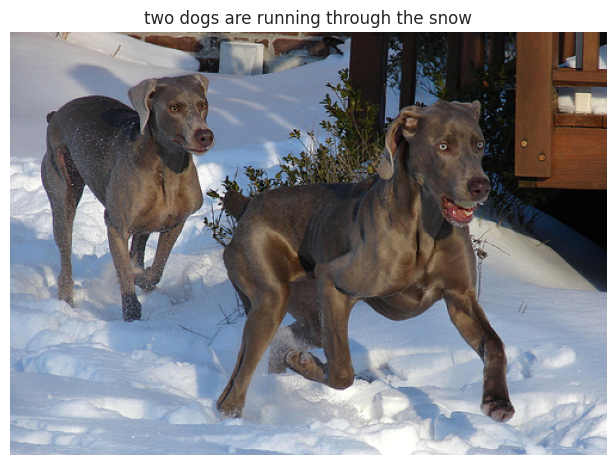

actual captions
dog enjoys romp in the water with mountains and sand in the background
dog running at the shore of lake
white dog is running in pond near the shore
white dog running through the water on the shore edge
the white dog ran in the shallow water


Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 14.38it/s]


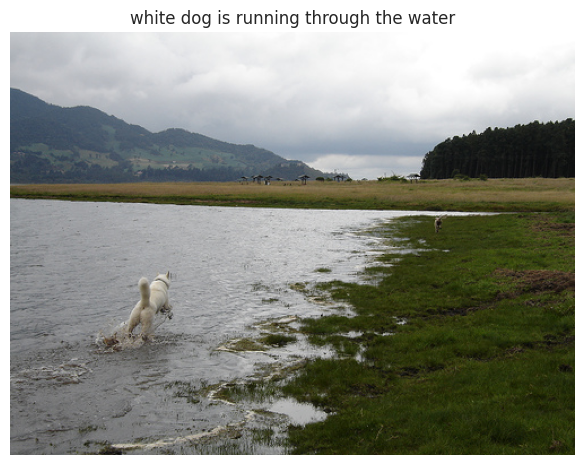

actual captions
people
man in an orange vest is standing next to yellow canoe
people tend canoes at the edge of body of water during dimly lit time of day
the men are getting their kayaks secured on the beach for the night
two men standing on the shore beside their kayaks at dusk


Generating caption:  10%|▉         | 3/31 [00:00<00:02, 12.45it/s]


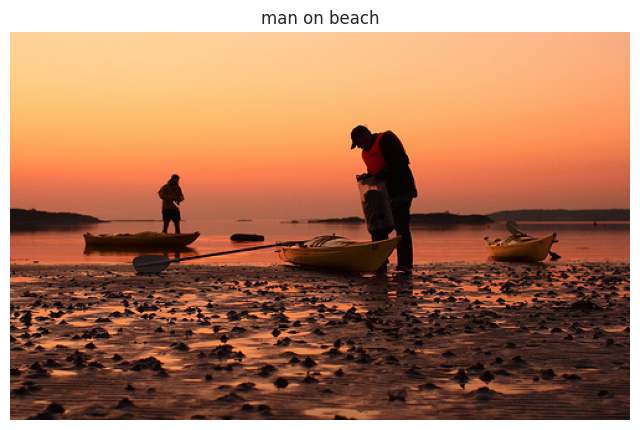

actual captions
black and white dog is jumping over hurdle
black and white dog jumps over bar in an agility test
dog jumps over hurdle on grass field
dog leaps over bar on an obstacle course
the black and white dog jumps over an obstacle


Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 14.51it/s]


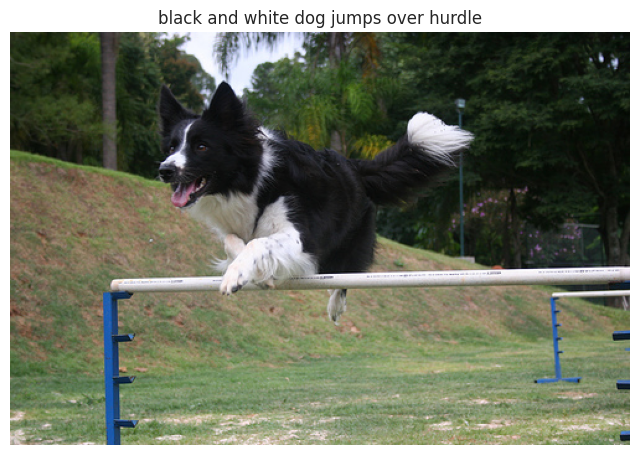

actual captions
baby being held by small girl
child supports toddler underwater in pool
small girl and toddler swimming underwater in pool
young girl and baby boy are swimming underwater in pool
two children smile underwater


Generating caption:  16%|█▌        | 5/31 [00:00<00:02, 12.88it/s]


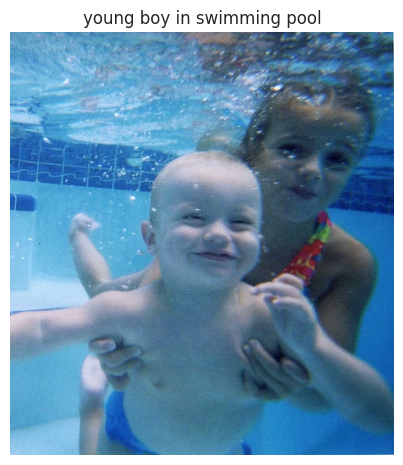

actual captions
brown dog is running along beach
brown dog wearing black collar running across the beach
dog walks on the sand near the water
brown dog running on the beach
the large brown dog is running on the beach by the ocean


Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 14.45it/s]


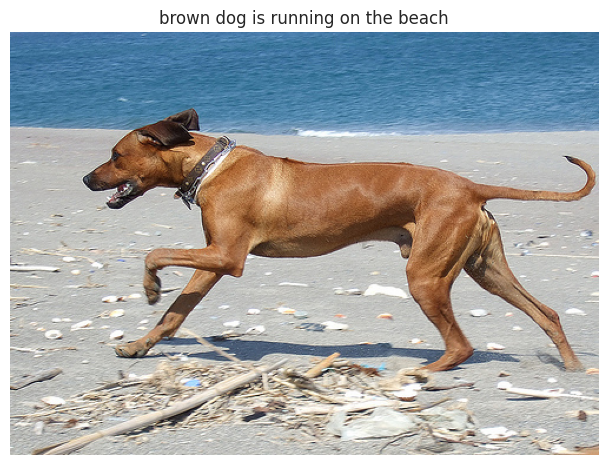

actual captions
black dog splashes through the water
brown and tan dog is running through shallow water
dog is running in the ocean beside the beach
dog running through water
dog splashes running across water


Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 14.36it/s]


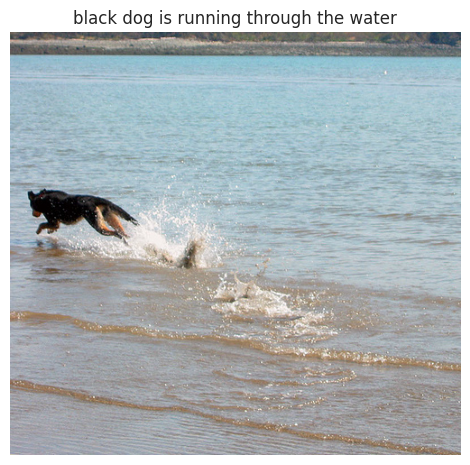

actual captions
the two boys
two boys are playing in the sand at playground
two boys tussle in the sand at park
two boys wrestle together in the sand
two young boys are wrestling in sand pit


Generating caption:  26%|██▌       | 8/31 [00:00<00:01, 14.87it/s]


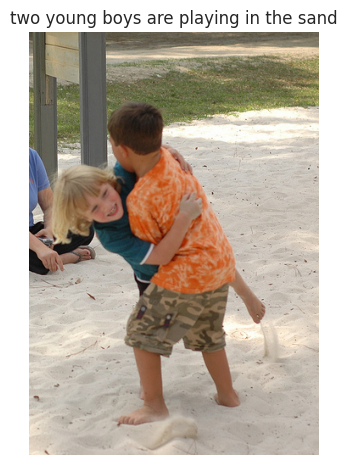

worst test results
actual captions
child is jumping into an inflatable swimming pool
girl plays in an inflatable pool
girl plays in small pool
little girl plays in blow up pool
small girl in bathing suit jumps above kiddie pool


Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 14.62it/s]


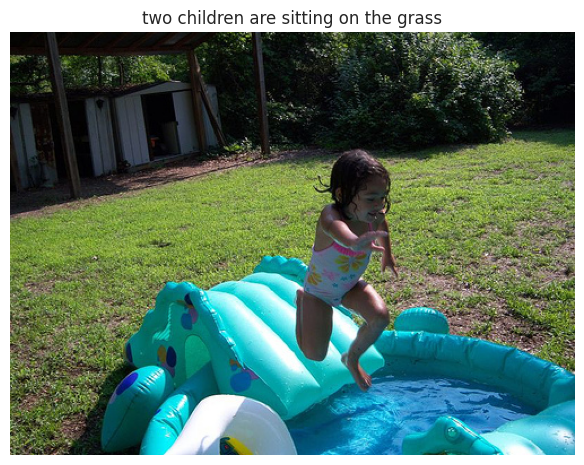

actual captions
the hikers take tandem leap while crossing the bridge
two guys jumping up while crossing bridge
two men are jumping in the air whilst crossing wooden bridge
two people are jumping on bridge in the mountains
two young men jump on bridge


Generating caption:  19%|█▉        | 6/31 [00:00<00:01, 13.79it/s]


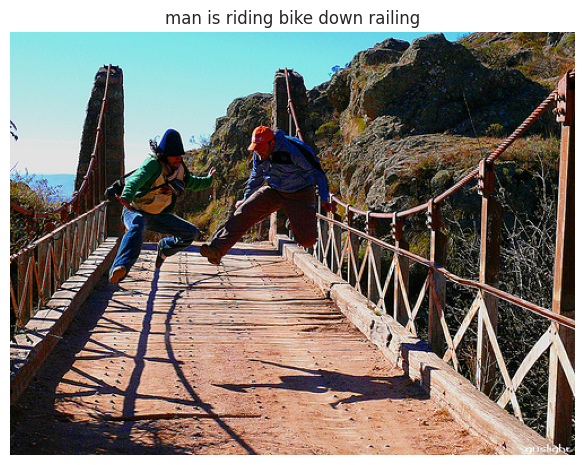

actual captions
black policeman is smiling at larger woman
policeman grins at woman wearing beads on crowded street
policeman hugging woman on the street
police officer has his arm around woman on the street
woman chats with smiling police officer


Generating caption:  32%|███▏      | 10/31 [00:00<00:01, 14.99it/s]


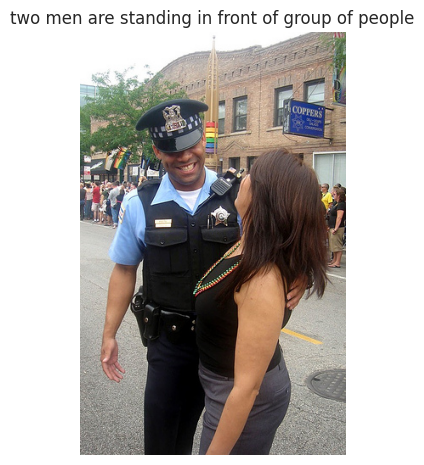

actual captions
child at party swings bat at pinata
little boy in an orange collared shirt is swinging baseball bat
little boy in red shirt is swinging at pinata
little boy in orange hit the pinata as man stands behind him
the small boy in an orange shirt gets some help from an adult while swinging at pinata


Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 14.71it/s]


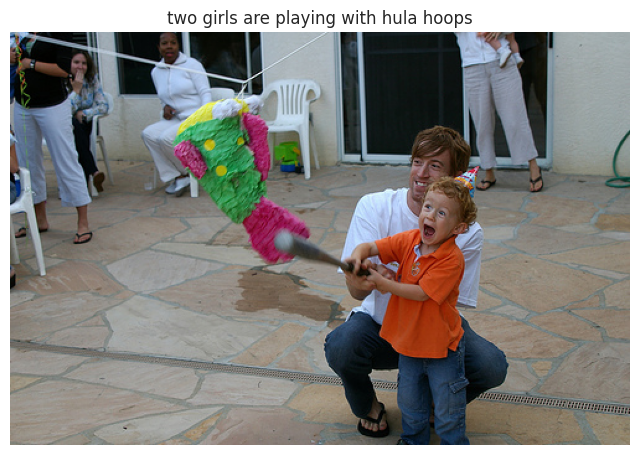

actual captions
boy in blue carries bucket
boy in blue swim trunks carries blue bucket down crowded beach
child walks on the beach with bucket
the boy in the blue shorts is carrying bucket on the beach
young boy in blue shorts at the beach


Generating caption:  16%|█▌        | 5/31 [00:00<00:01, 14.13it/s]


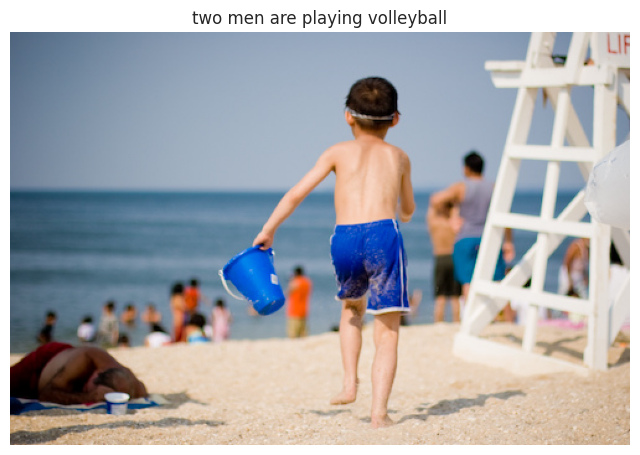

actual captions
two guys are playing horse shoe together
two guys playing horseshoe
two men playing horseshoes
two men wearing jeans and sunglasses are playing horseshoes
two people play horseshoes


Generating caption:  29%|██▉       | 9/31 [00:00<00:01, 15.22it/s]


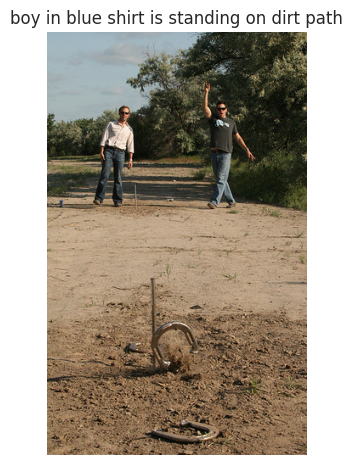

actual captions
man in beige trench coat is walking in the rain
man in tan trench coat and blue jeans walks with black umbrella open over his head
man in trench coat is walking with an umbrella
man with white hair
man walking with his umbrella in bleak street


Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 14.78it/s]


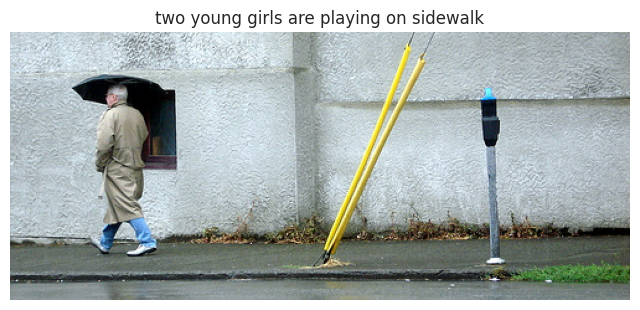

actual captions
child pulls another in small wagon
toddler in red jacket and jeans pulling another toddler wearing green hat and jacket and red paints in red wagon
toddler in dirty jeans attampts to pull younger child in wagon
young boy pulls another boy wearing silly hat in radio flyer wagon
one child pulls another


Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 14.71it/s]


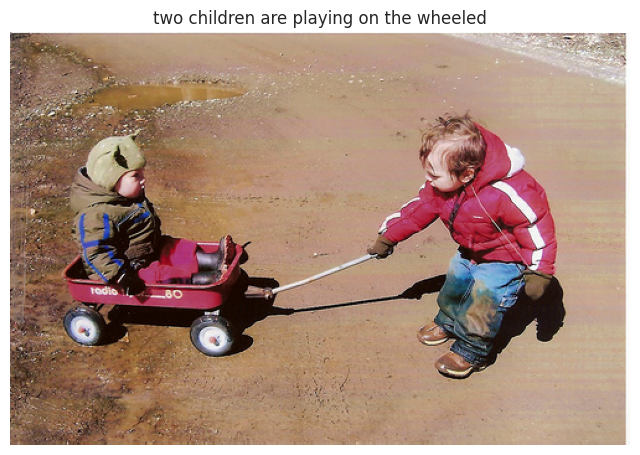

actual captions
man in black shirt enjoys snack while woman in white shirt looks confused
man is eating from paper cone while woman stands behind him
man is standing in front of woman while eating something
one dark skinned man is eating french fries and blond woman is standing behind him
the man white purple and white polka dotted shirts is eating and looking to his right while the woman behind him has confused look on her face


Generating caption:  16%|█▌        | 5/31 [00:00<00:01, 13.17it/s]


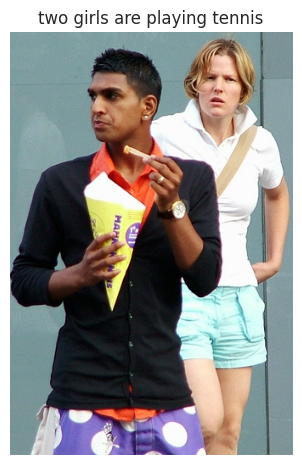

actual captions
hikers cross bridge over fast moving stream and rocky scenery
people crossing long bridge over canyon with river
people walk across rope bridge over rocky stream
some hikers are crossing wood and wire bridge over river
three people are looking across rope and wood bridge over river


Generating caption:  19%|█▉        | 6/31 [00:00<00:01, 14.19it/s]


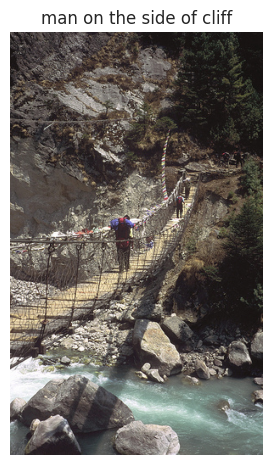

In [ ]:
best_ids, worst_ids = evaluate_test_set(test_descriptions, test_images_encoding, predict_caption)

# Print the results
# print("Top 10 Best Performing Image IDs:", best_ids)
# print("Top 10 Worst Performing Image IDs:", worst_ids)

plt.style.use("seaborn")
print("best test results")
for id in best_ids:
    photo_2048 = test_images_encoding[id].reshape((1,feature_vector_length))

    i = plt.imread("/kaggle/input/flickr8k/Images/"+id)
    print("actual captions")
    for cap in test_descriptions[id]:
        print(cap)

    caption = predict_caption(photo_2048)
    #print(caption)

    plt.title(caption)
    plt.imshow(i)
    plt.axis("off")
    plt.show()

print("worst test results")
for id in worst_ids:
    photo_2048 = test_images_encoding[id].reshape((1,feature_vector_length))

    i = plt.imread("/kaggle/input/flickr8k/Images/"+id)
    print("actual captions")
    for cap in test_descriptions[id]:
        print(cap)

    caption = predict_caption(photo_2048)
    #print(caption)

    plt.title(caption)
    plt.imshow(i)
    plt.axis("off")
    plt.show()

In [ ]:
def create_caption_external_image (image_path):
    image_feature_vec = get_image_encoding(image_path)
    predicted_caption = predict_caption(image_feature_vec.reshape((1, 2048)))

    plt.style.use("seaborn")
    i = plt.imread(image_path)
    plt.title(predicted_caption)
    plt.imshow(i)
    plt.axis("off")
    plt.show()

In [ ]:
def visualize_captions(image_dir, start_id, end_id):
    for img_id in range(start_id, end_id + 1):
        image_path = os.path.join(image_dir, f"{img_id}.jpg")
        print(img_id)
        if os.path.exists(image_path):
            # Get the predicted caption
            create_caption_external_image(image_path)
        else:
            print(f"Image {image_path} does not exist.")

1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


Generating caption:  35%|███▌      | 11/31 [00:00<00:01, 13.39it/s]
/tmp/ipykernel_34/3684529235.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


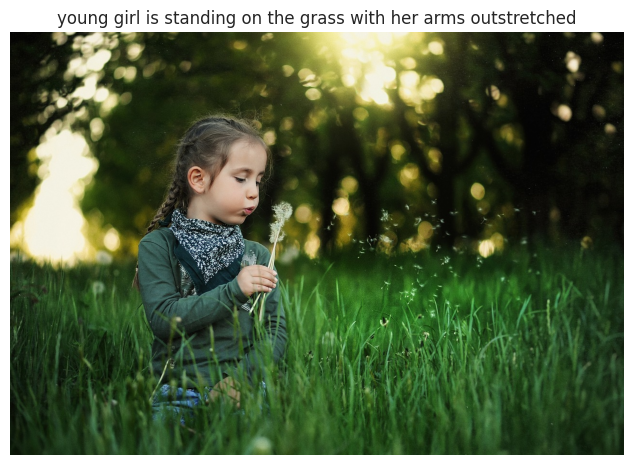

2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 13.00it/s]
/tmp/ipykernel_34/3684529235.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


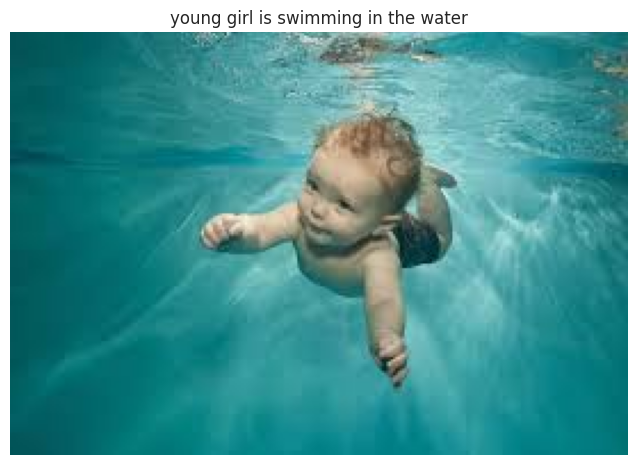

3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Generating caption:  26%|██▌       | 8/31 [00:00<00:01, 13.04it/s]
/tmp/ipykernel_34/3684529235.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


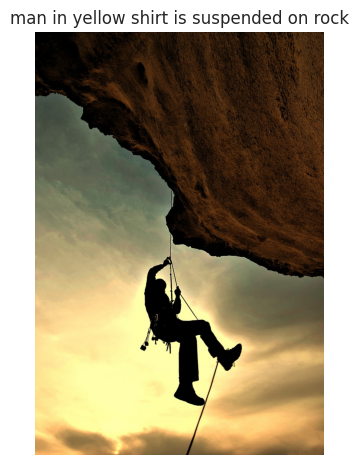

4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Generating caption:  13%|█▎        | 4/31 [00:00<00:02, 11.73it/s]
/tmp/ipykernel_34/3684529235.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


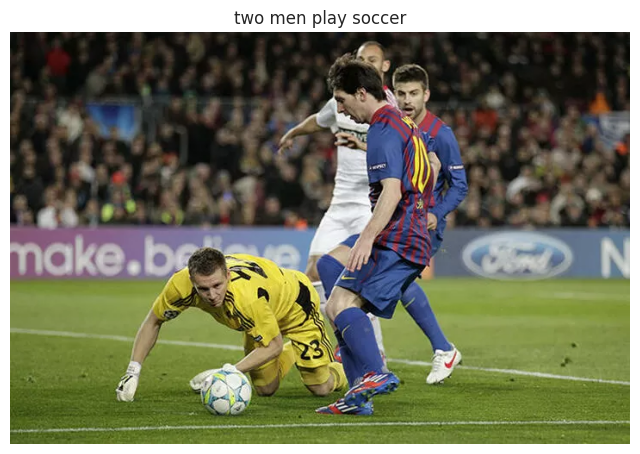

5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 13.33it/s]
/tmp/ipykernel_34/3684529235.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


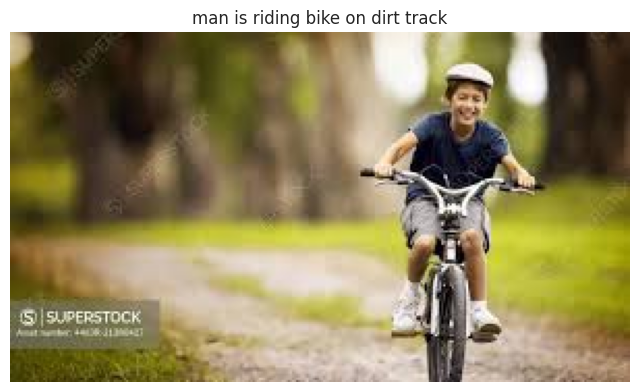

6
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Generating caption:  19%|█▉        | 6/31 [00:00<00:01, 13.19it/s]
/tmp/ipykernel_34/3684529235.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


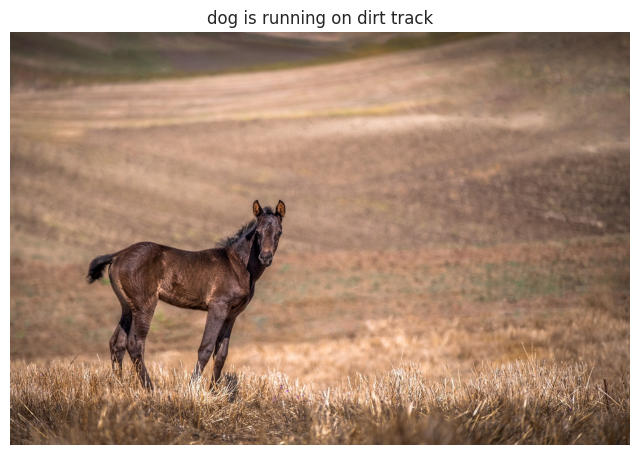

7
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Generating caption:  19%|█▉        | 6/31 [00:00<00:01, 13.28it/s]
/tmp/ipykernel_34/3684529235.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


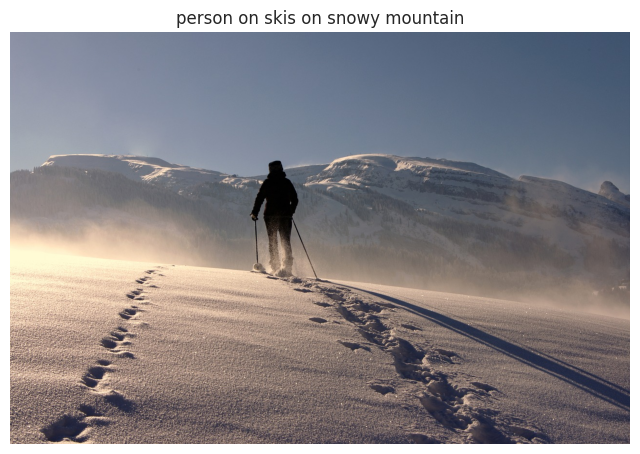

8
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


Generating caption:  32%|███▏      | 10/31 [00:00<00:01, 13.68it/s]
/tmp/ipykernel_34/3684529235.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


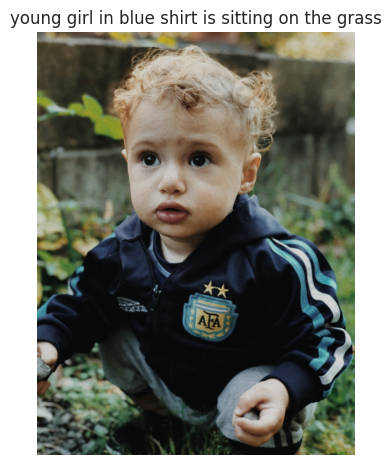

9
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Generating caption:  19%|█▉        | 6/31 [00:00<00:01, 12.75it/s]
/tmp/ipykernel_34/3684529235.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


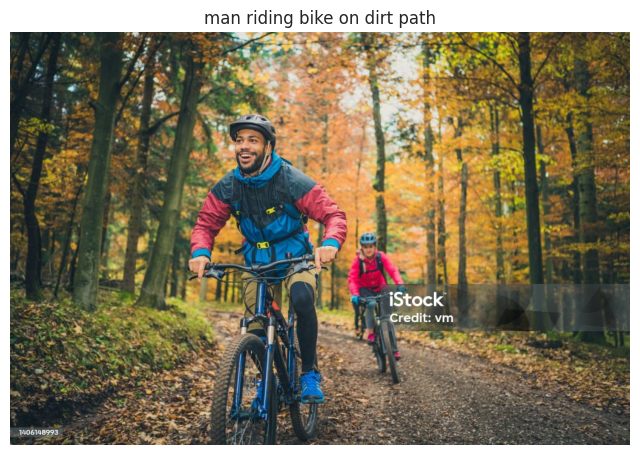

10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 13.58it/s]
/tmp/ipykernel_34/3684529235.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


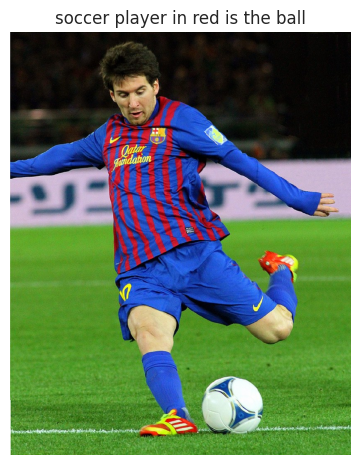

11
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Generating caption:  29%|██▉       | 9/31 [00:00<00:01, 14.16it/s]
/tmp/ipykernel_34/3684529235.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


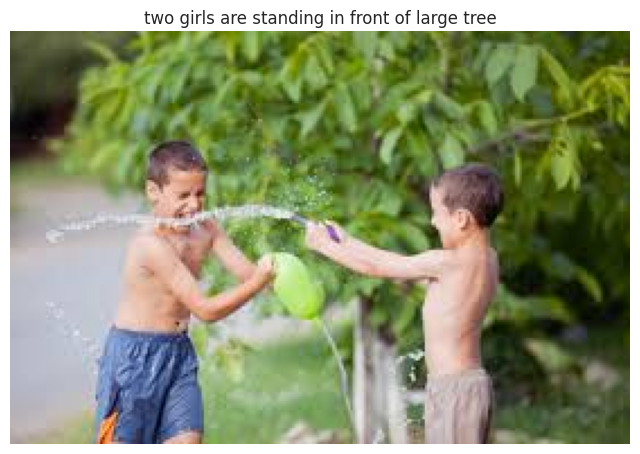

12
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


Generating caption:  29%|██▉       | 9/31 [00:00<00:01, 14.18it/s]
/tmp/ipykernel_34/3684529235.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


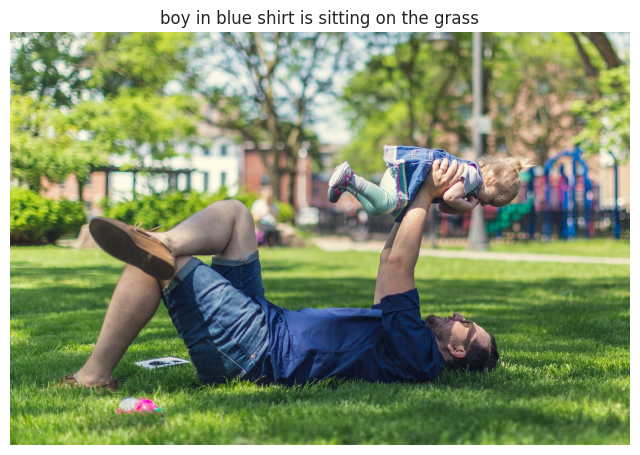

13
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Generating caption:  32%|███▏      | 10/31 [00:00<00:01, 13.77it/s]
/tmp/ipykernel_34/3684529235.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


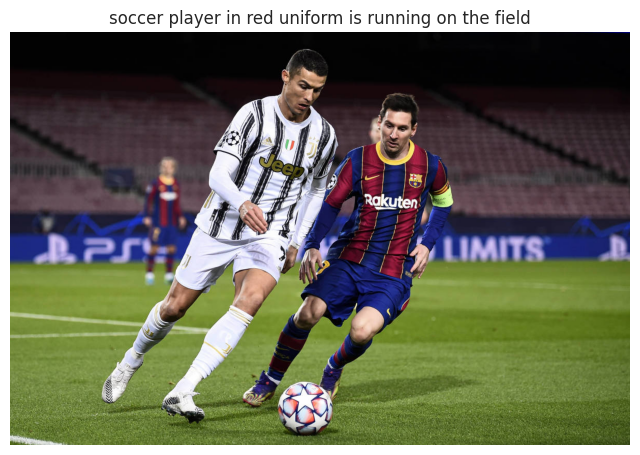

14
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 13.89it/s]
/tmp/ipykernel_34/3684529235.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


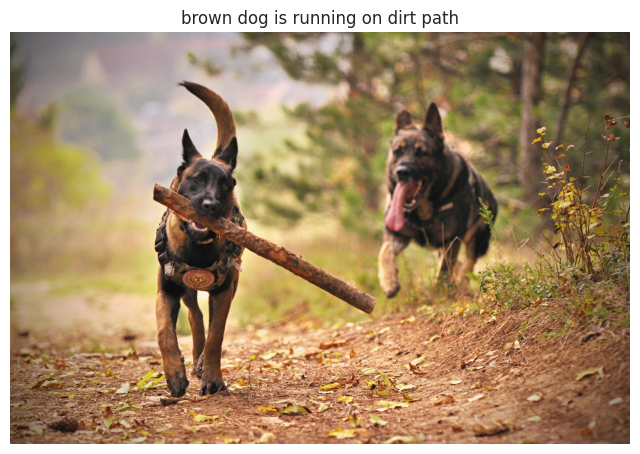

15
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


Generating caption:  29%|██▉       | 9/31 [00:00<00:01, 13.92it/s]
/tmp/ipykernel_34/3684529235.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


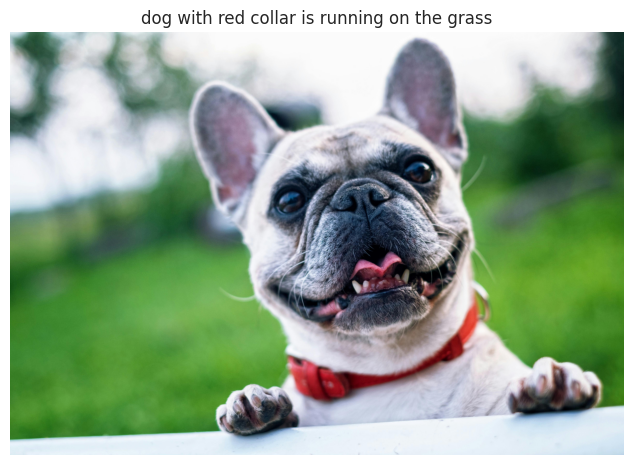

16
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Generating caption:  26%|██▌       | 8/31 [00:00<00:01, 13.84it/s]
/tmp/ipykernel_34/3684529235.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


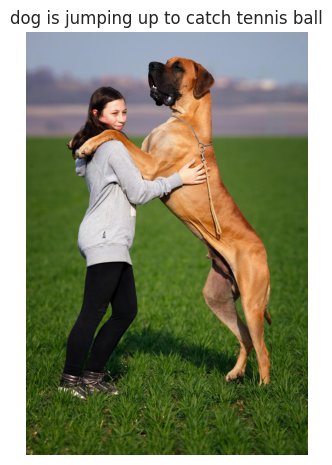

17
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 13.86it/s]
/tmp/ipykernel_34/3684529235.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


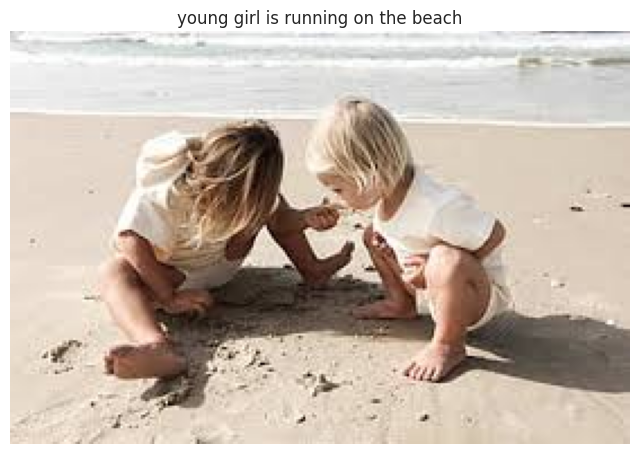

18
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


Generating caption:  32%|███▏      | 10/31 [00:00<00:01, 14.54it/s]
/tmp/ipykernel_34/3684529235.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


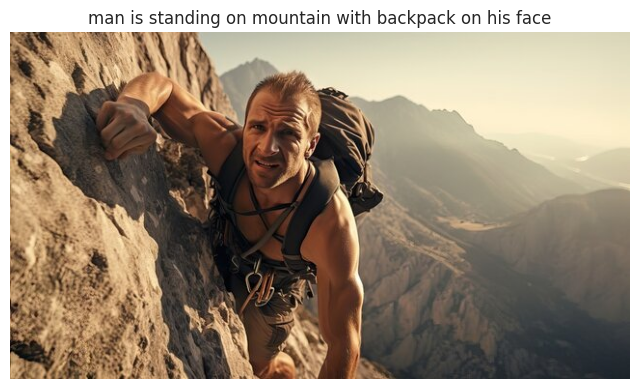

19
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Generating caption:  16%|█▌        | 5/31 [00:00<00:01, 13.31it/s]
/tmp/ipykernel_34/3684529235.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


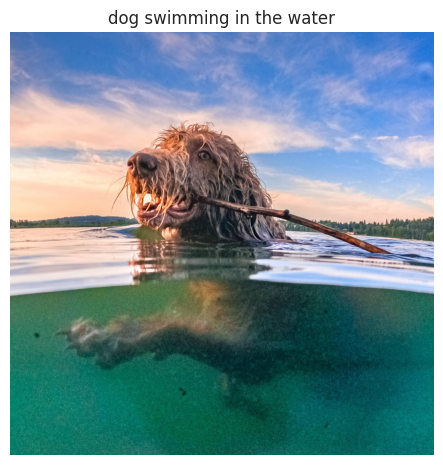

In [ ]:
# Example usage
image_dir = "/kaggle/input/collecetes-testing-images"
visualize_captions(image_dir, 1, 19)

visualize some random data

/tmp/ipykernel_34/4047627601.py:2: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")
Generating caption:  26%|██▌       | 8/31 [00:00<00:01, 12.74it/s]


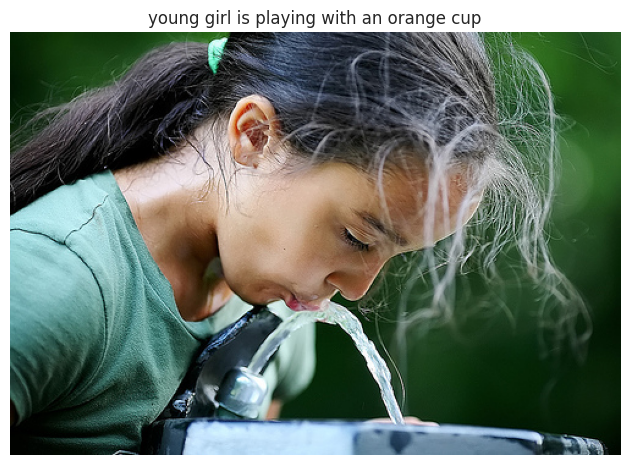

Generating caption:  26%|██▌       | 8/31 [00:00<00:01, 12.23it/s]


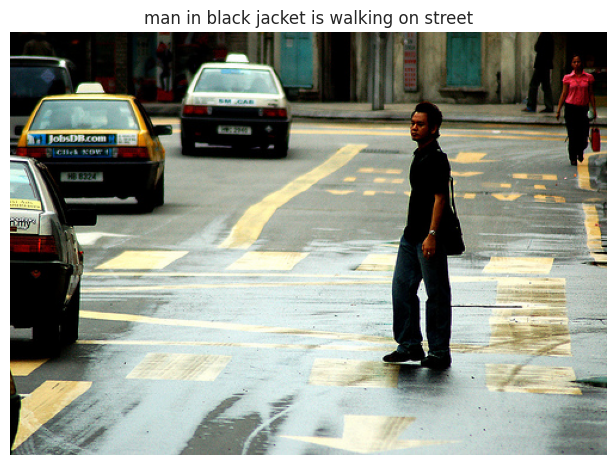

Generating caption:  19%|█▉        | 6/31 [00:00<00:01, 12.69it/s]


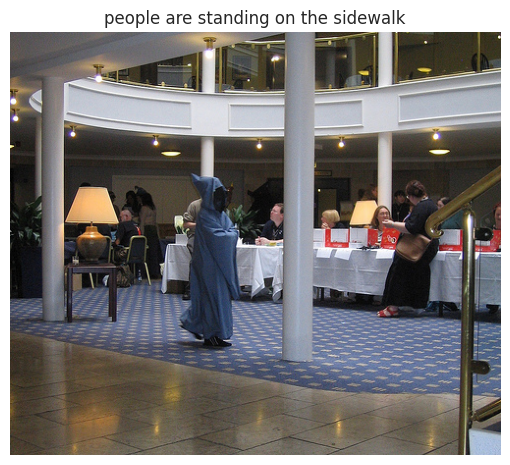

Generating caption:  35%|███▌      | 11/31 [00:00<00:01, 13.49it/s]


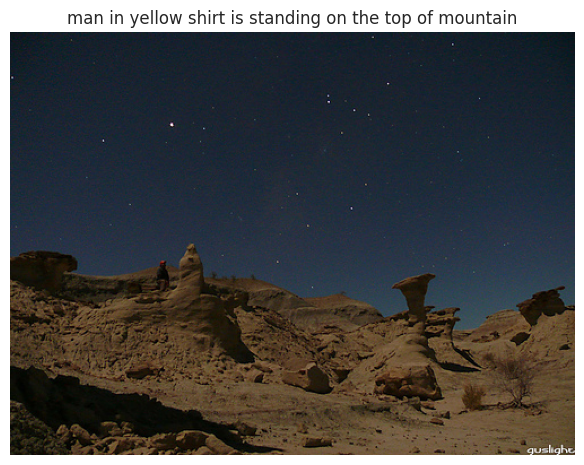

Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 13.08it/s]


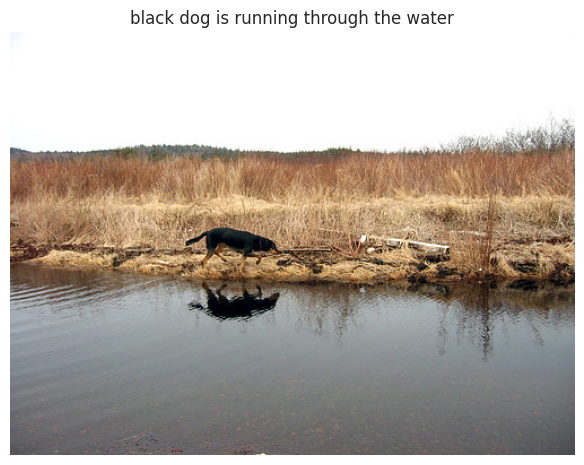

Generating caption:  19%|█▉        | 6/31 [00:00<00:01, 12.56it/s]


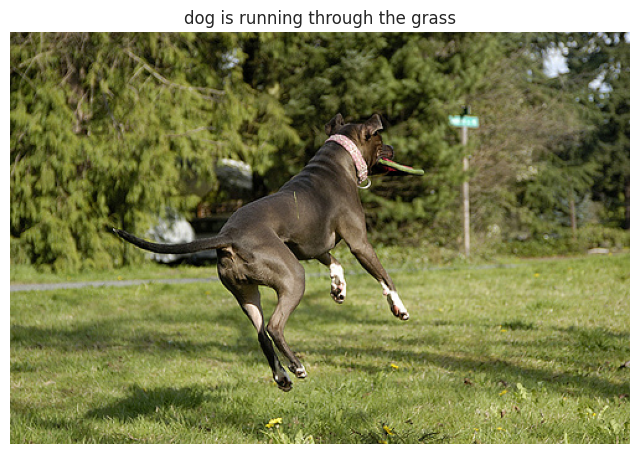

Generating caption:  19%|█▉        | 6/31 [00:00<00:02, 11.69it/s]


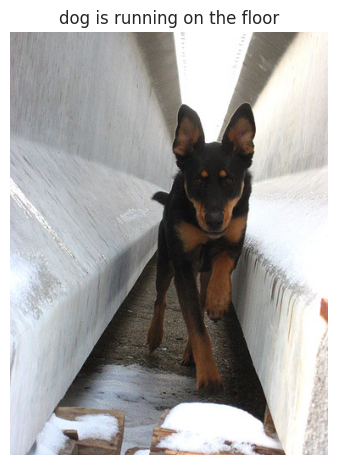

Generating caption:  13%|█▎        | 4/31 [00:00<00:02, 11.80it/s]


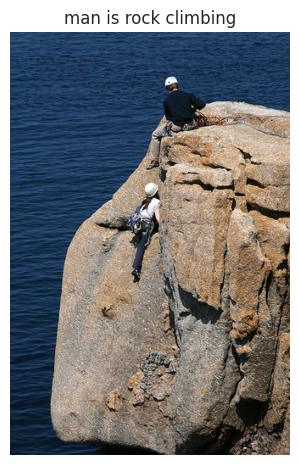

Generating caption:  16%|█▌        | 5/31 [00:00<00:02, 12.42it/s]


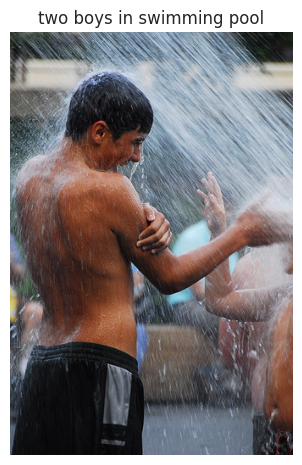

Generating caption:  39%|███▊      | 12/31 [00:00<00:01, 14.11it/s]


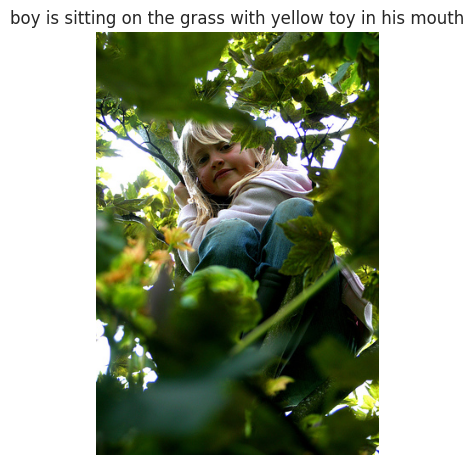

Generating caption:  32%|███▏      | 10/31 [00:00<00:01, 13.94it/s]


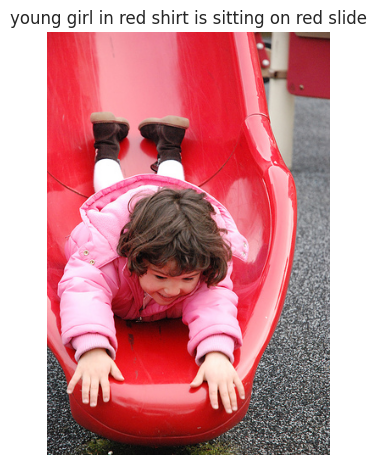

Generating caption:  26%|██▌       | 8/31 [00:00<00:01, 13.42it/s]


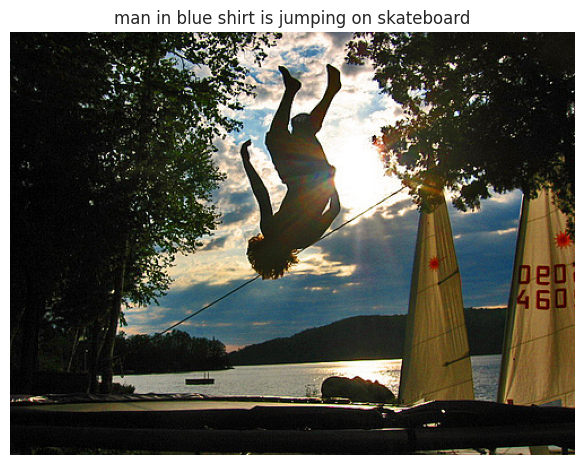

Generating caption:  29%|██▉       | 9/31 [00:00<00:01, 13.72it/s]


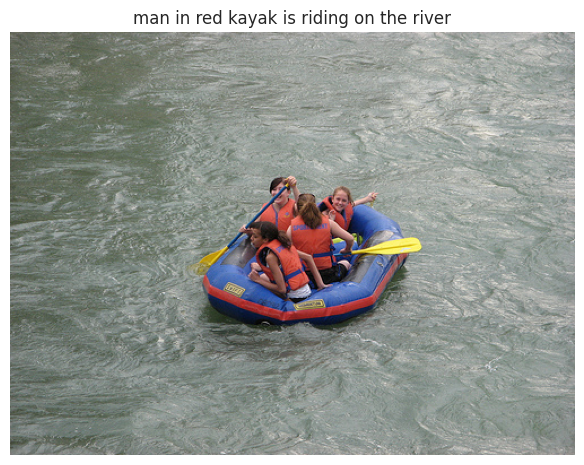

Generating caption:  29%|██▉       | 9/31 [00:00<00:01, 13.63it/s]


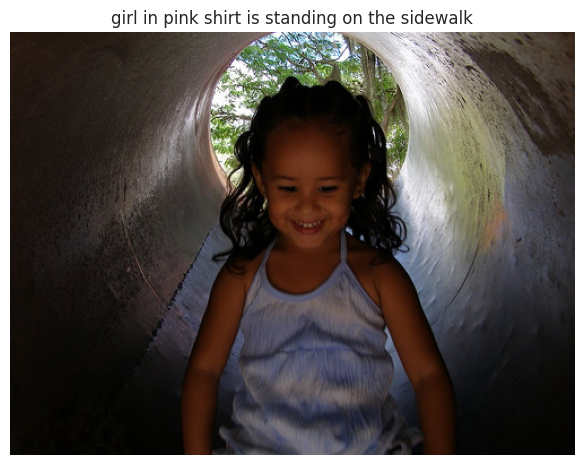

Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 13.29it/s]


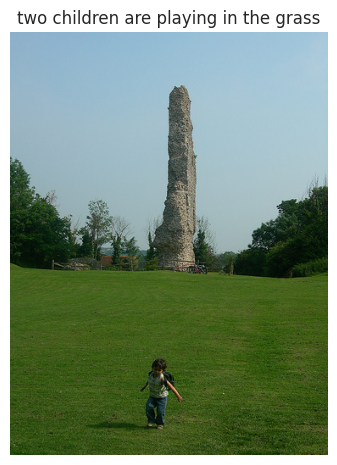

Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 13.19it/s]


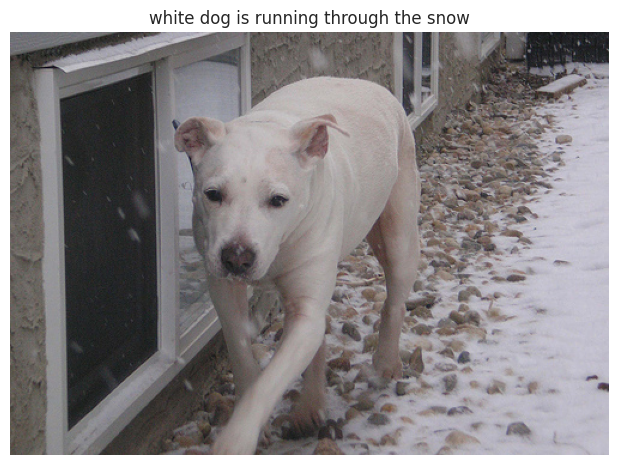

Generating caption:  29%|██▉       | 9/31 [00:00<00:01, 13.77it/s]


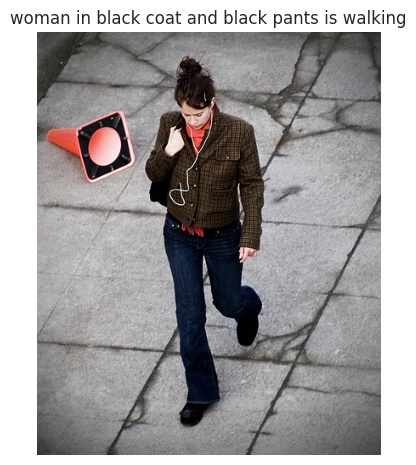

Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 12.21it/s]


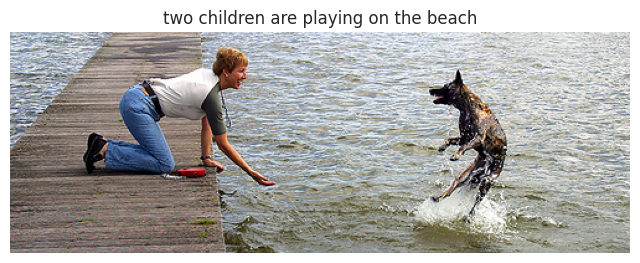

Generating caption:  35%|███▌      | 11/31 [00:00<00:01, 13.63it/s]


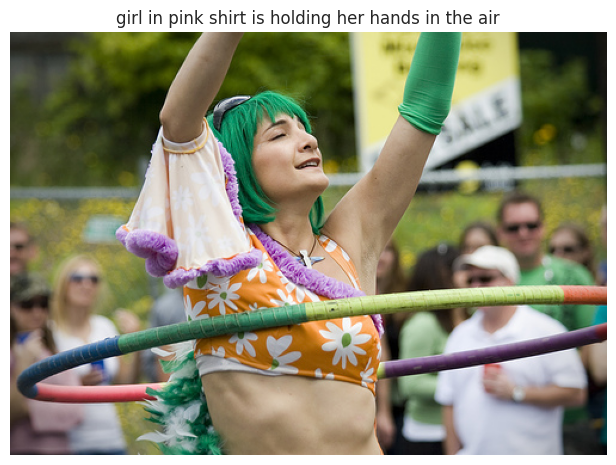

Generating caption:  26%|██▌       | 8/31 [00:00<00:01, 13.56it/s]


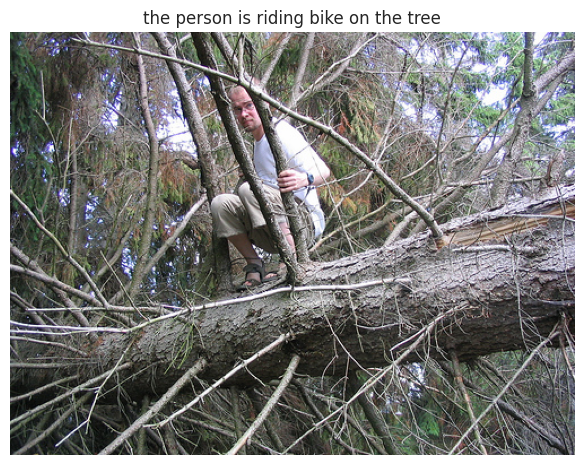

Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 13.62it/s]


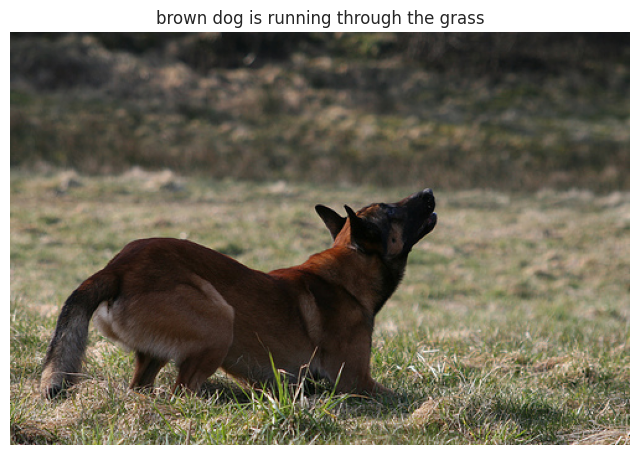

Generating caption:  32%|███▏      | 10/31 [00:00<00:01, 13.72it/s]


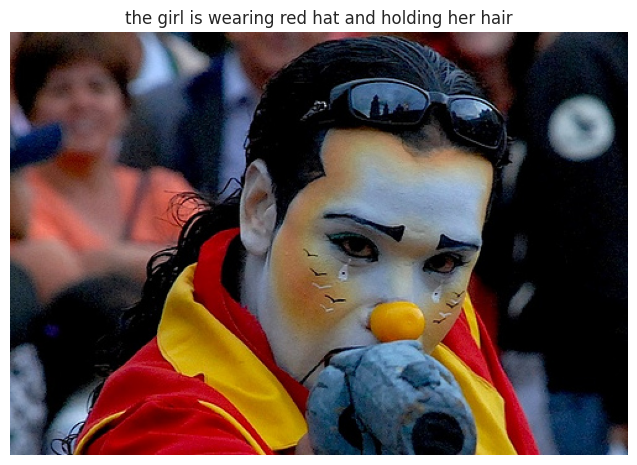

Generating caption:  19%|█▉        | 6/31 [00:00<00:01, 13.13it/s]


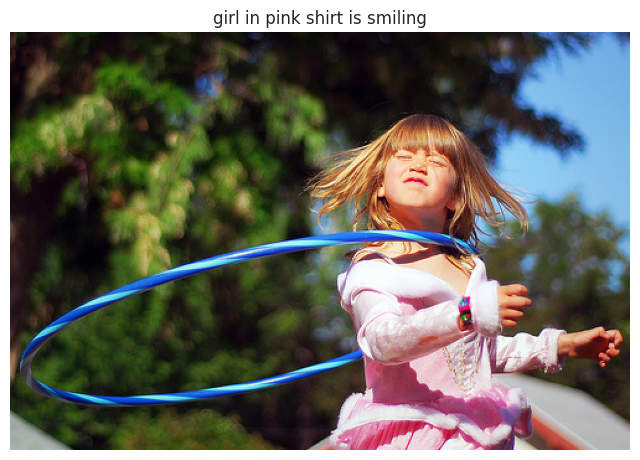

Generating caption:  29%|██▉       | 9/31 [00:00<00:01, 14.07it/s]


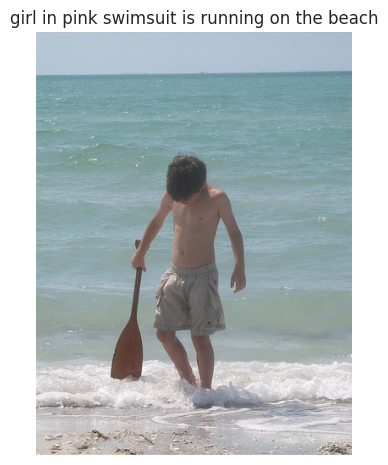

Generating caption:  23%|██▎       | 7/31 [00:00<00:01, 12.83it/s]


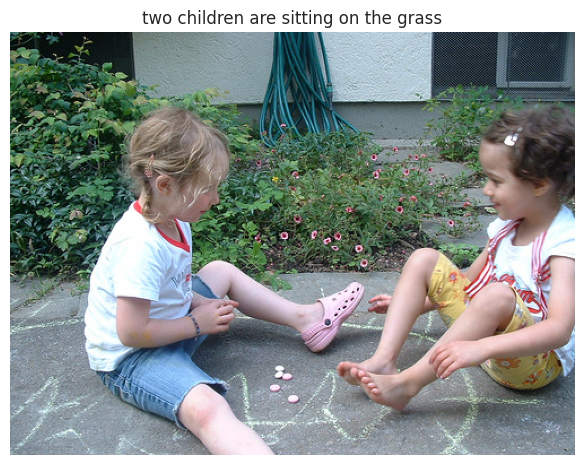

Generating caption:  32%|███▏      | 10/31 [00:00<00:01, 13.82it/s]


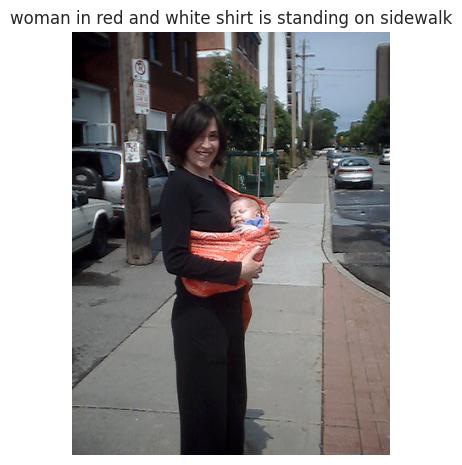

Generating caption:  29%|██▉       | 9/31 [00:00<00:01, 13.67it/s]


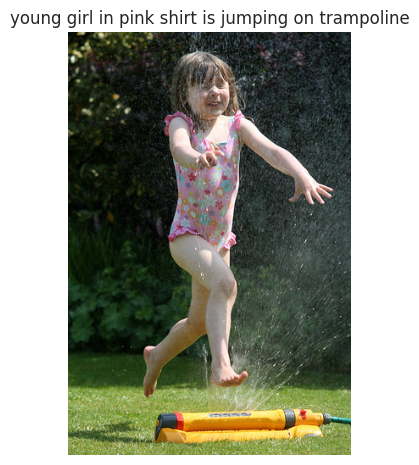

Generating caption:  19%|█▉        | 6/31 [00:00<00:01, 12.54it/s]


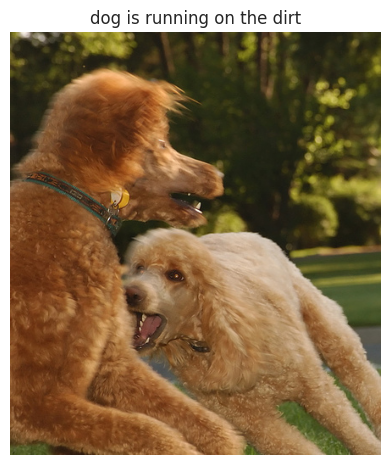

Generating caption:  26%|██▌       | 8/31 [00:00<00:01, 14.09it/s]


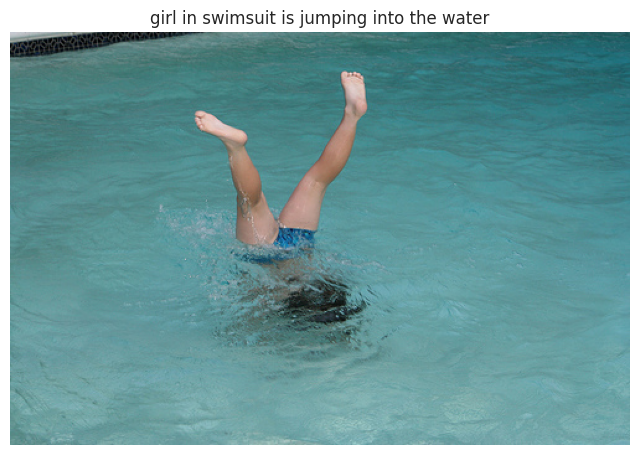

Generating caption:  32%|███▏      | 10/31 [00:00<00:01, 14.06it/s]


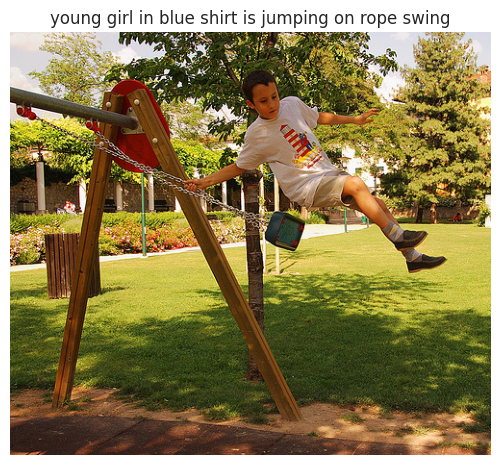

In [ ]:
# Pick Some Random Images and See Results
plt.style.use("seaborn")
for i in range(30):
    idx = np.random.randint(0,1000)
    all_img_names = list(test_images_encoding.keys())
    img_name = all_img_names[idx]
    photo_2048 = test_images_encoding[img_name].reshape((1,feature_vector_length))

    i = plt.imread("/kaggle/input/flickr8k/Images/"+img_name)

    caption = predict_caption(photo_2048)
    #print(caption)

    plt.title(caption)
    plt.imshow(i)
    plt.axis("off")
    plt.show()